In [2]:
# process the inhibition study
# run simulations with same parameters.
# calculate motifs. compare with the real network

In [3]:
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import brian2
import pickle
import networkx as nx
import copy
import seaborn as sns
from plotFunc import plotPaperTag, getConnHist, getNnodeLoop, plotXYcompr, plotXYcomprCorr, plotXYcomprResidual, plotXYLogReg
import json
from adjustText import adjust_text

import itertools
from pathlib import Path

# from ipynb.fs.defs.makeFigures import generateColorMap, generateColorbar

# load model class
from circuitModel import model

mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
plt.rcParams['svg.fonttype'] = 'none'

In [4]:
from plotFunc import plotPaperTag, getConnHist, getNnodeLoop, plotXYcompr, plotXYcomprCorr, plotXYcomprResidual, plotXYLogReg

In [6]:
# load arealist
area_list = list(np.loadtxt('results/area_list.csv', delimiter=',', dtype='str'))
thal_list = list(np.loadtxt('results/thal_list.csv', delimiter=',', dtype='str'))
# load connectivity 
conn_cxcx = np.loadtxt('results/conn_cxcx.csv', delimiter=',')

conn_cxth = np.loadtxt('results/conn_cxth.csv', delimiter=',')
conn_thcx = np.loadtxt('results/conn_thcx.csv', delimiter=',')

# load interneuron density
normPVgrad_df = pd.read_csv('results/dfPV.csv', header = 0, index_col=0)
normSSTgrad_df = pd.read_csv('results/dfSST.csv', header = 0, index_col=0)

# load hierarchy
hierarchy_df = pd.read_csv('results/dfHier.csv', header=0, index_col=0)
hierlist = list(hierarchy_df['hierarchy index'])
# load model

with open('results/model_V1.pkl', 'rb') as f:
    model_V1 = pickle.load(f)

FRDefault = float(np.loadtxt('results/FRdefault.csv', delimiter=","))

In [7]:
# define divisions from Harris et al.
div = {'somatomotor':['SSp-bfd','SSp-tr','SSp-ll','SSp-ul',
                     'SSp-un','SSp-n','SSp-m','SSs','MOp','MOs'],
      'visual':['VISal','VISl','VISp','VISpl',
                'VISli','VISpor','VISrl'],
      'medial':['VISa','VISam','VISpm','RSPagl',
               'RSPd','RSPv'],
      'prefrontal':['FRP','ACAd','ACAv','PL',
                   'ILA','ORBl','ORBm','ORBvl'],
      'lateral':['AId','AIv','AIp','VISC',
                 'GU','TEa','PERI','ECT'],
      'auditory':['AUDd','AUDp','AUDpo','AUDv']}

div_color_list = np.array([[255, 140, 0],
                           [169, 164, 217],
                           [22, 37, 128],
                           [220,20,60],
                           [218,165,32],
                           [91,  0,  105]])/255

div_name_list = ['somatomotor',
                 'visual',
                 'medial',
                 'prefrontal',
                 'lateral',
                 'auditory']

In [8]:

# loadFolder = 'tempdata/results22May17_1/'
testFolder = 'results/'
# with open(testFolder + 'allpars.pkl', 'rb') as f:
#     model = pickle.load(f)
    
with open(testFolder + 'allpars.pkl', 'rb') as file:  # open parameter file
    [parameters, conn_cxcx, pref_matrix,
     hierarchy_df, normPVgrad_df, normSSTgrad_df,
     area_list, conn_thcx, conn_cxth, thal_list] = pickle.load(file)
    

In [9]:
# generate a list of stim pattern

# AreaList = [area_list[i] for i in np.argsort(list(hierarchy_df['hierarchy index']))][::-1]
# print(AreaList)

# stimAreaList = ['PL','ORBm','VISpm','AId','ORBl','ILA','VISal','ECT','PERI','RSPagl','GU','RSPd','RSPv','VISpl','VISrl','MOp']
# stimAreaList = ['AIv','ACAd','ACAv','ORBvl','MOs','VISam','VISa','TEa','AUDpo','FRP','VISpor','PL','ORBm','VISpm','AId','ORBl','ILA','VISal','ECT','PERI','RSPagl','GU']
# stimAreaList = AreaList
stimAreaList = area_list
# stimAreaList = ['VISa','TEa','AUDpo','FRP','VISpor','PL','ORBm','VISpm','AId','ORBl','ILA','VISal','ECT','PERI','RSPagl','GU']
nc = len(stimAreaList)


# note that this could be automatic calc.
areasShowPA = ['AIv','ACAd','ACAv','ORBvl','MOs','VISam','VISa','TEa','AUDpo','FRP','VISpor','PL','ORBm','VISpm','AId','ORBl','ILA','VISal','ECT','PERI','RSPagl','GU']

print(len(stimAreaList), len(area_list), len(areasShowPA), stimAreaList[:5])


43 43 22 ['VISp', 'AUDp', 'SSp-ll', 'AUDd', 'SSp-n']


In [10]:
stimPatternList = [] # stimpatternlist
for i in [0]:
    stimPatternList += itertools.combinations(stimAreaList, i + 1)
    # stimPatternList.append((stimAreaList[i],))
npattern = len(stimPatternList)
print(len(stimAreaList), len(stimPatternList))
print(stimPatternList[:10])

43 43
[('VISp',), ('AUDp',), ('SSp-ll',), ('AUDd',), ('SSp-n',), ('SSp-ul',), ('AIp',), ('SSp-m',), ('SSp-un',), ('SSp-bfd',)]


In [11]:
area_list[20:30]

['RSPd', 'GU', 'RSPagl', 'PERI', 'ECT', 'VISal', 'ILA', 'ORBl', 'AId', 'VISpm']

['VISp']
VISp
VISp
simulation start: 
sim done.
3.93E-03
['AUDp']
VISp
AUDp
simulation start: 
sim done.
3.93E-03
['SSp-ll']
VISp
SSp-ll
simulation start: 
sim done.
3.92E-03
['AUDd']
VISp
AUDd
simulation start: 
sim done.
3.93E-03
['SSp-n']
VISp
SSp-n
simulation start: 
sim done.
3.92E-03
['SSp-ul']
VISp
SSp-ul
simulation start: 
sim done.
3.92E-03
['AIp']
VISp
AIp
simulation start: 
sim done.
4.05E-03
['SSp-m']
VISp
SSp-m
simulation start: 
sim done.
3.92E-03
['SSp-un']
VISp
SSp-un
simulation start: 
sim done.
3.92E-03
['SSp-bfd']
VISp
SSp-bfd
simulation start: 
sim done.
3.92E-03
['VISl']
VISp
VISl
simulation start: 


WARNING    /Users/Allen/PycharmProjects/xingyu-mouse-large-scale-wm/notebooks/circuitModel.py:909: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
 [py.warnings]


sim done.
3.92E-03
['AUDv']
VISp
AUDv
simulation start: 
sim done.
3.97E-03
['SSs']
VISp
SSs
simulation start: 
sim done.
3.94E-03
['VISC']
VISp
VISC
simulation start: 
sim done.
4.03E-03
['SSp-tr']
VISp
SSp-tr
simulation start: 
sim done.
3.91E-03
['VISli']
VISp
VISli
simulation start: 
sim done.
3.92E-03
['MOp']
VISp
MOp
simulation start: 
sim done.
3.93E-03
['VISrl']
VISp
VISrl
simulation start: 
sim done.
3.92E-03
['VISpl']
VISp
VISpl
simulation start: 
sim done.
3.93E-03
['RSPv']
VISp
RSPv
simulation start: 
sim done.
3.89E-03
['RSPd']
VISp
RSPd
simulation start: 
sim done.
3.89E-03
['GU']
VISp
GU
simulation start: 
sim done.
7.05E-03
['RSPagl']
VISp
RSPagl
simulation start: 
sim done.
4.00E-03
['PERI']
VISp
PERI
simulation start: 
sim done.
1.21E-02
['ECT']
VISp
ECT
simulation start: 
sim done.
1.18E-02
['VISal']
VISp
VISal
simulation start: 
sim done.
3.55E-03
['ILA']
VISp
ILA
simulation start: 
sim done.
9.08E-03
['ORBl']
VISp
ORBl
simulation start: 
sim done.
3.24E-03
['AId']


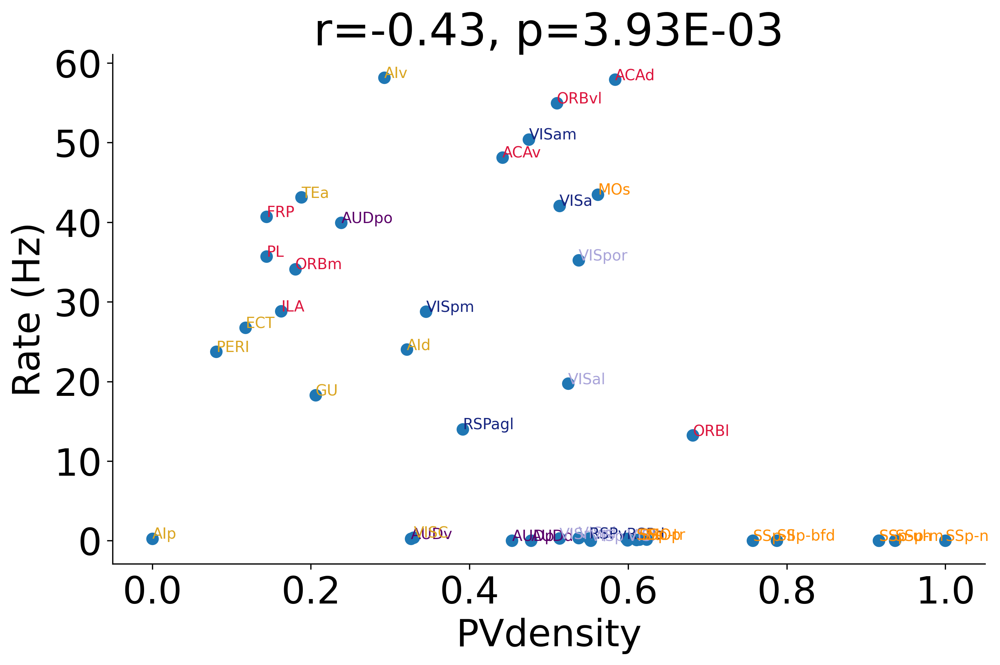

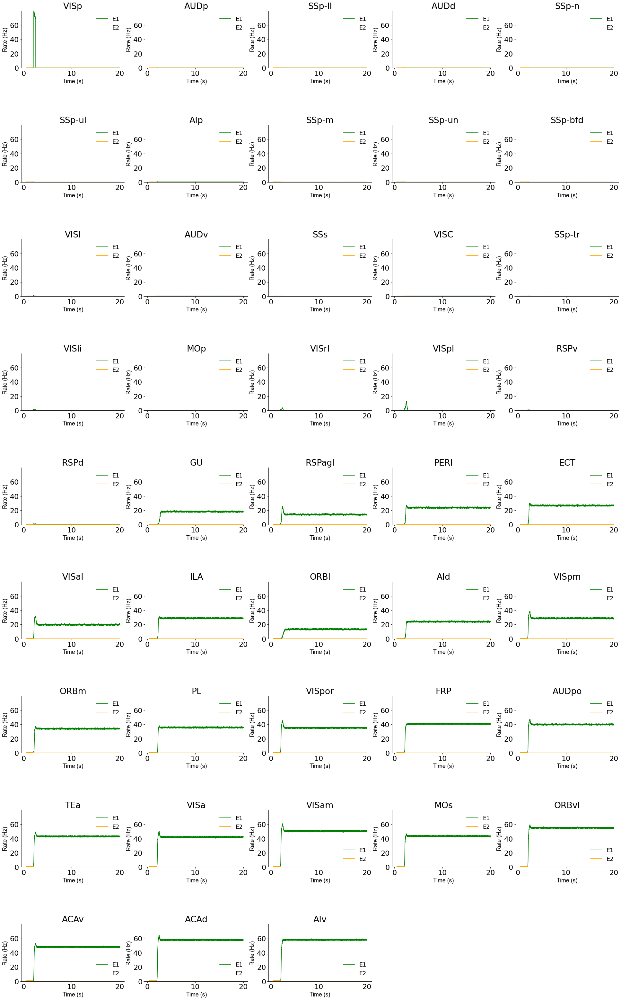

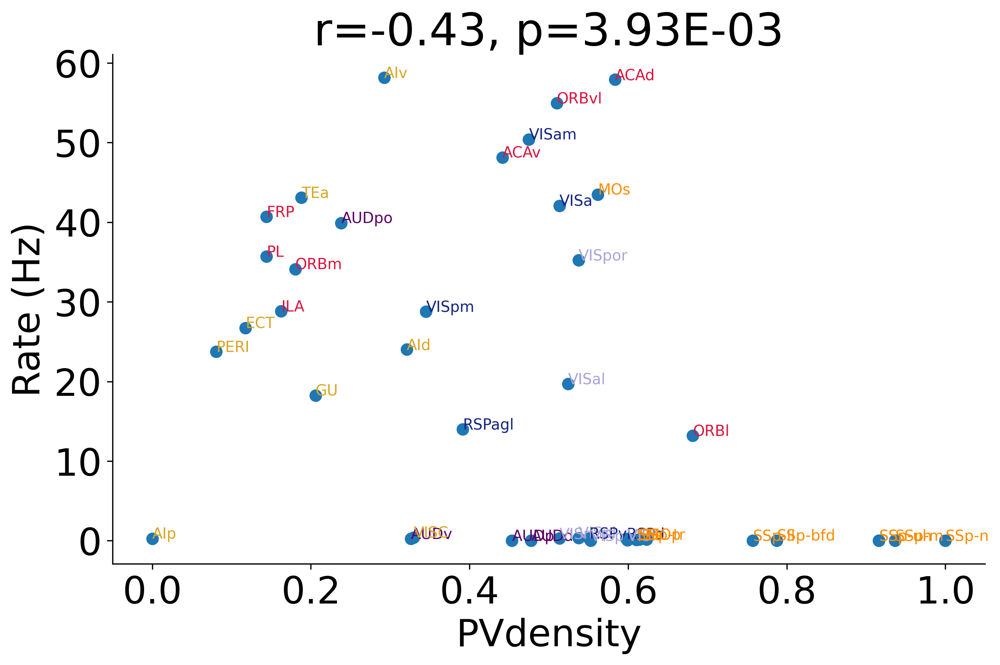

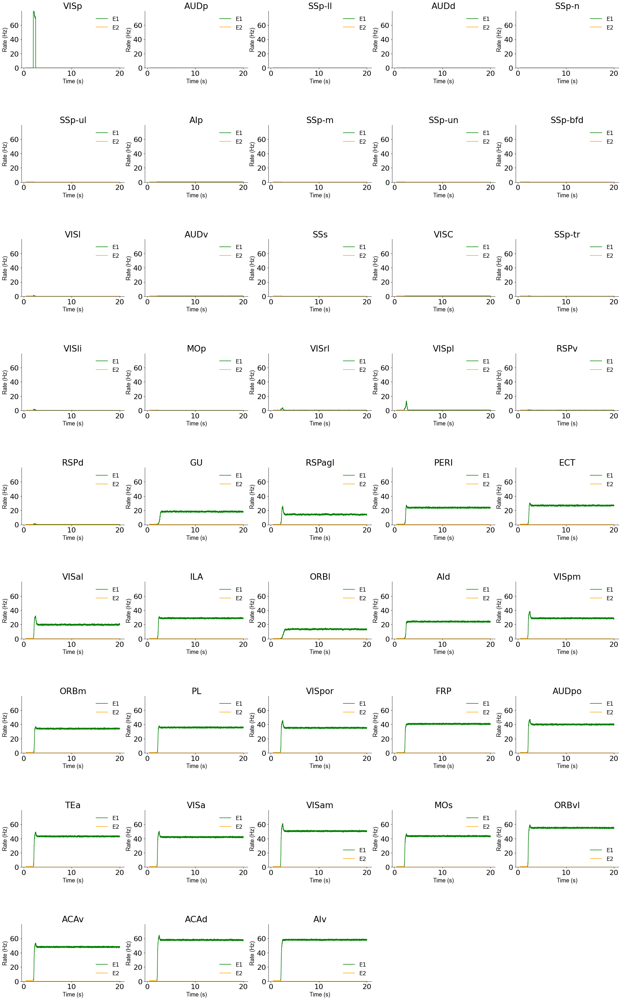

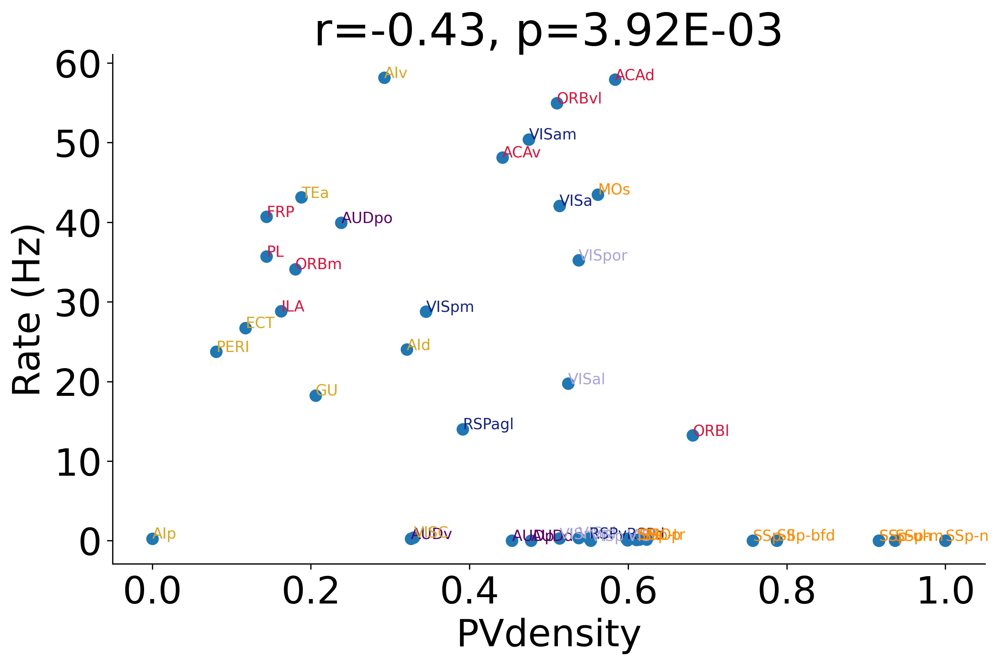

...

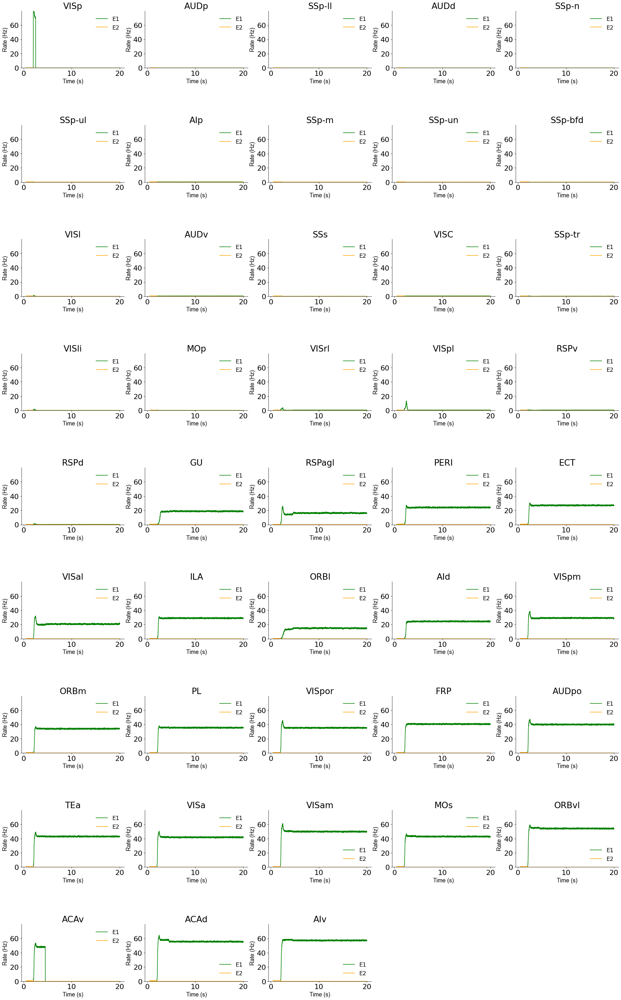

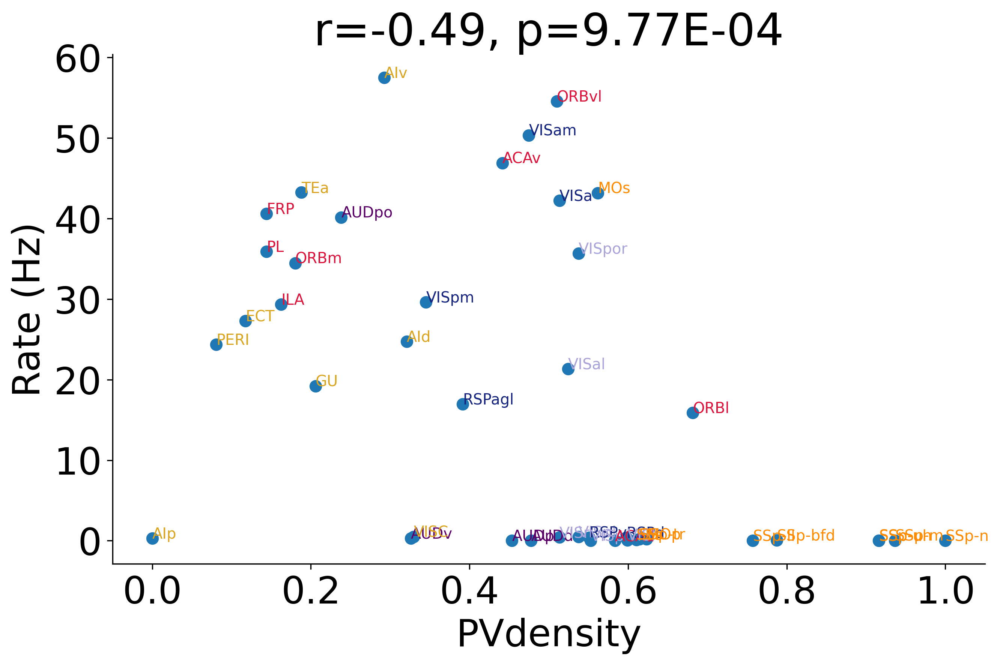

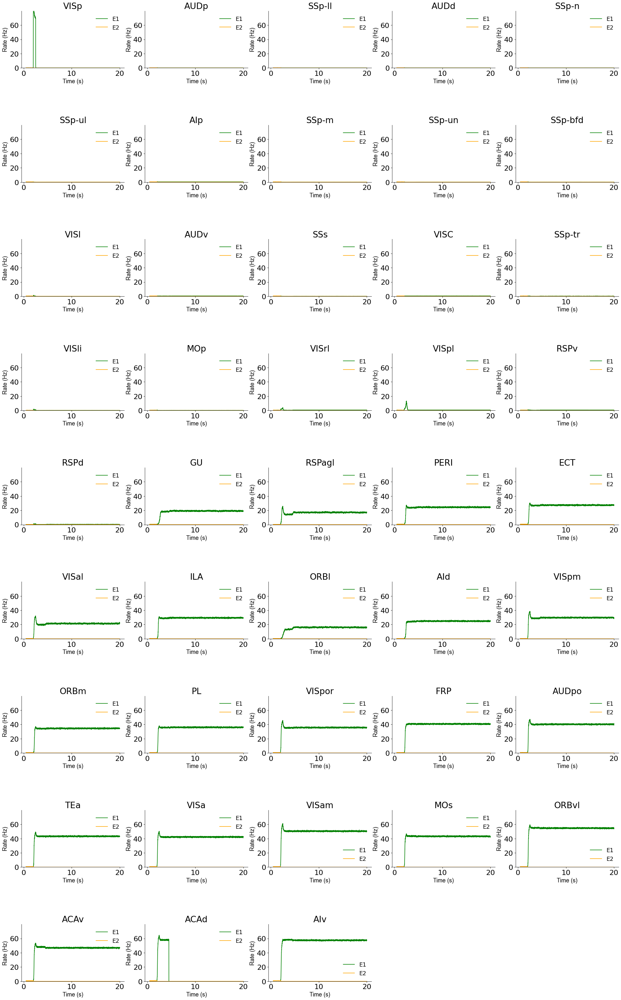

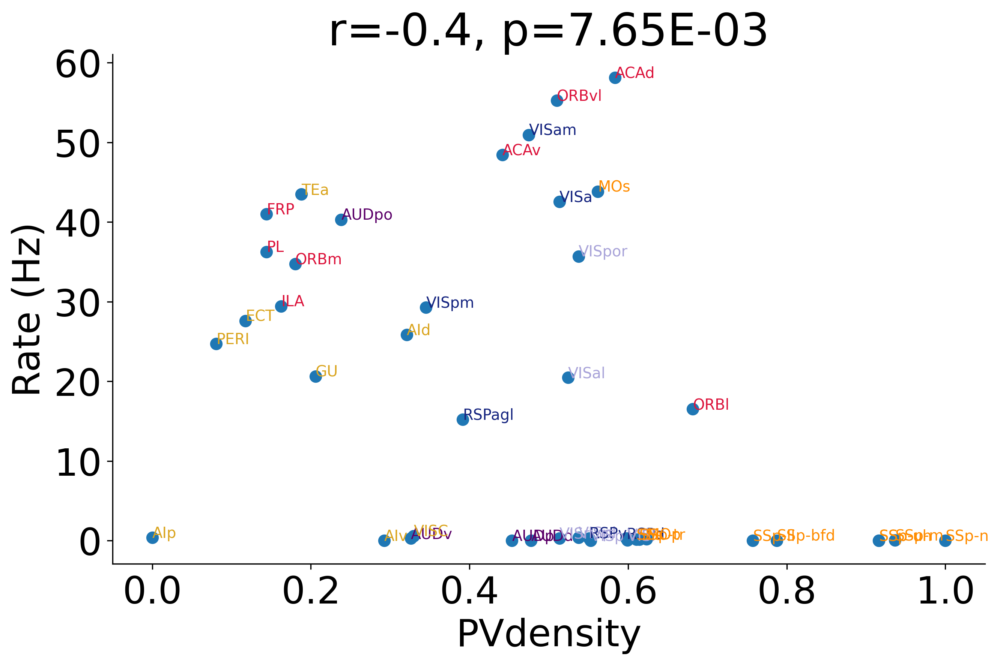

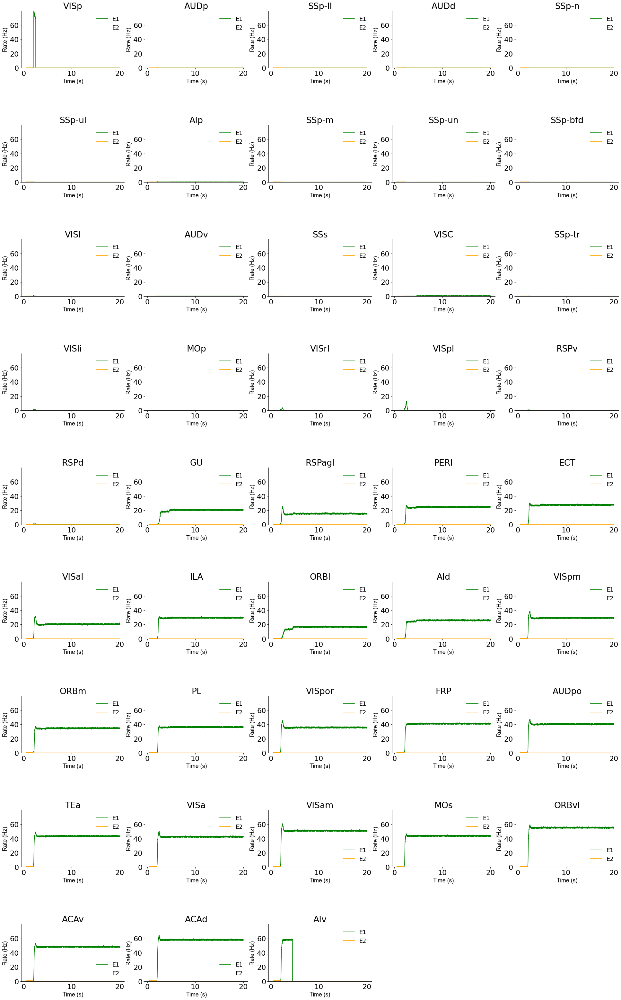

In [36]:
# do not loading the cluster simulation data. instead just run simulations locally. 
# original code: circuitModelClust.py

# we dont'  change the parameters. we have same parameters for all simulations. 
# always stimulate v1.
# inhibit differnet aeras in different simulaitons 
# output data is pamat, a matrix of delay activity under each simulation.

# init parameters
thcxmodel = False
PAthreshold = 5
savefigflag = False
makeQuickPlot = True

# init results matrix
allRateMatrix = np.zeros((len(stimPatternList), len(area_list)))

for i, areaTuple in enumerate(stimPatternList):
    print(list(areaTuple))
    current_parameters = copy.copy(parameters)
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    # current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['trial_length'] = 20000 * brian2.ms # trial length (s)
    curModel = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        curModel.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 
        # add delay period inhition
        curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')
        # curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'], current_parameters['trial_length'], 'I')
    curModel.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,_,_] = curModel.save_delay_activity('tempdata/',False)
    persistentact_df =  curModel.generatePAdf(PAthreshold)
    if makeQuickPlot:
        curModel.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        curModel.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

    allRateMatrix[i, :] = persistentactlist
    # maxBaseMatrixReference[i, ] = np.max(baselineactlistReference)
    # # get the number of elements larger than 5 in persistentactlist
    # numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])


In [39]:
# save and load the results for future use

# np.savetxt('results/allRateMatrix_single_inhibit.txt', allRateMatrix)


allRateMatrix = np.loadtxt('results/allRateMatrix_single_inhibit.txt')
print(allRateMatrix.shape)

(43, 43)


<Figure size 432x288 with 0 Axes>

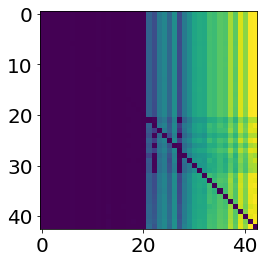

<Figure size 432x288 with 0 Axes>

In [37]:
plt.imshow(allRateMatrix)
plt.figure()
# # flip pamat in diagonal and plot it
# plt.imshow(pamat[:,20:34].T)
# plt.figure()
# plt.imshow(pamat[:,20:34].T - allRateMatrix[:14,:])
# plt.colorbar()

In [14]:
area_list[20:30]
core = [21, 24, 26, 28, 29, 30, 31] # [21, 23, 24, 26, 28, 29, 30, 31]
print('core',[area_list[i] for i in core])
nonCore = [22, 23, 25, 27] + list(np.arange(32,43))

nonCoreAreaList = [area_list[i] for i in nonCore]
print('nonCore',nonCore, nonCoreAreaList)

core ['GU', 'ECT', 'ILA', 'AId', 'VISpm', 'ORBm', 'PL']
nonCore [22, 23, 25, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42] ['RSPagl', 'PERI', 'VISal', 'ORBl', 'VISpor', 'FRP', 'AUDpo', 'TEa', 'VISa', 'VISam', 'MOs', 'ORBvl', 'ACAv', 'ACAd', 'AIv']


In [15]:
nonCorePatternList_pair_noncore = []
for k in [2]:
    nonCorePatternList_pair_noncore += itertools.combinations(nonCore, k)
NnonCorepattern = len(nonCorePatternList_pair_noncore)
print(len(nonCore), len(nonCorePatternList_pair_noncore))
print(nonCorePatternList_pair_noncore[:10])

15 105
[(22, 23), (22, 25), (22, 27), (22, 32), (22, 33), (22, 34), (22, 35), (22, 36), (22, 37), (22, 38)]


In [25]:
# run simulations with inhibition on multiple non core areas. 

# we dont'  change the parameters. we have same parameters for all simulations. 
# always stimulate v1.
# inhibit differnet aeras in different simulaitons 
# output data is pamat, a matrix of delay activity under each simulation.

# generate stim pattern list 2 3 4 5 6 etc. Focus on the non core areas.
# noncore areas list. 

# init parameters
thcxmodel = False
PAthreshold = 5
savefigflag = False
makeQuickPlot = False

# init results matrix
allRateMatrix_pair_noncore = np.zeros((len(nonCorePatternList_pair_noncore), len(area_list)))

for i, areaTuple in enumerate(nonCorePatternList_pair_noncore):
    stimulatelist = [area_list[i] for i in areaTuple]
    print(stimulatelist)
    current_parameters = copy.copy(parameters)
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    # current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['trial_length'] = 10000 * brian2.ms # trial length (s)
    curModel = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        curModel.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 
        # add delay period inhition
        curModel.add_input(50*current_parameters['stim_strength'], stimulatelist, current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')
        # curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'], current_parameters['trial_length'], 'I')
    curModel.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,_,_] = curModel.save_delay_activity('tempdata/',False)
    persistentact_df =  curModel.generatePAdf(PAthreshold)
    if makeQuickPlot:
        curModel.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        curModel.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

    allRateMatrix_pair_noncore[i, :] = persistentactlist
    # maxBaseMatrixReference[i, ] = np.max(baselineactlistReference)
    # # get the number of elements larger than 5 in persistentactlist
    # numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])


['RSPagl', 'PERI']
VISp
RSPagl
PERI
simulation start: 
sim done.
['RSPagl', 'VISal']
VISp
RSPagl
VISal
simulation start: 
sim done.
['RSPagl', 'ORBl']
VISp
RSPagl
ORBl
simulation start: 
sim done.
['RSPagl', 'VISpor']
VISp
RSPagl
VISpor
simulation start: 
sim done.
['RSPagl', 'FRP']
VISp
RSPagl
FRP
simulation start: 
sim done.
['RSPagl', 'AUDpo']
VISp
RSPagl
AUDpo
simulation start: 
sim done.
['RSPagl', 'TEa']
VISp
RSPagl
TEa
simulation start: 
sim done.
['RSPagl', 'VISa']
VISp
RSPagl
VISa
simulation start: 
sim done.
['RSPagl', 'VISam']
VISp
RSPagl
VISam
simulation start: 
sim done.
['RSPagl', 'MOs']
VISp
RSPagl
MOs
simulation start: 
sim done.
['RSPagl', 'ORBvl']
VISp
RSPagl
ORBvl
simulation start: 
sim done.
['RSPagl', 'ACAv']
VISp
RSPagl
ACAv
simulation start: 
sim done.
['RSPagl', 'ACAd']
VISp
RSPagl
ACAd
simulation start: 
sim done.
['RSPagl', 'AIv']
VISp
RSPagl
AIv
simulation start: 
sim done.
['PERI', 'VISal']
VISp
PERI
VISal
simulation start: 
sim done.
['PERI', 'ORBl']
VISp
P

In [16]:
# save and load the results for future use

# np.savetxt('results/allRateMatrix_pair_noncore_inhibit.txt', allRateMatrix_pair_noncore)


allRateMatrix_pair_noncore = np.loadtxt('results/allRateMatrix_pair_noncore_inhibit.txt')
print(allRateMatrix_pair_noncore.shape)

(105, 43)


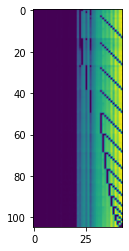

In [18]:
# method:
plt.imshow(allRateMatrix_pair_noncore[:,:])
# plt.figure()
# # flip pamat in diagonal and plot it
# plt.imshow(pamat[:,20:34].T)
# # plt.figure()
# # plt.imshow(pamat[:,20:34].T - allRateMatrix[:14,:])
# # plt.colorbar()


In [19]:
def getNonCoreInhibitionMeanFR(pamat, area_list, inh_idx_list, areasIndexShowPA, nonCorePatternList):
    countAreaAIv = 0
    frInhibitArea = np.zeros(len(area_list))
    frDict = {}
    nAreaDict = {}
    frList = FRDefault*np.ones(len(inh_idx_list))
    nAreaList = len(areasIndexShowPA)*np.ones(len(inh_idx_list))
    for i, stimP in enumerate(nonCorePatternList):
        pa = pamat[i, :]
        # get the average firing rate of areas with PA but no extra-inhibition.
        ROI = []
        for j in range(len(area_list)):
            if j in areasIndexShowPA and j not in stimP:
                ROI.append(pa[j])
        ROI = np.array(ROI)
        fr = np.mean(ROI)
        nAreaPA = sum(ROI > 5)

        for k in stimP:
            if k not in frDict:
                frDict[k] = []
            frDict[k].append(fr)
            if k not in nAreaDict:
                nAreaDict[k] = []
            nAreaDict[k].append(nAreaPA)
    print(frDict)
    for i in range(len(inh_idx_list)):
        k = inh_idx_list[i]
        if k in frDict:
            frList[i] = np.mean(frDict[k])
            nAreaList[i] = np.mean(nAreaDict[k])

    # for i in range(len(area_list)):
    #     if i in frDict:
    #         frList[i] = np.mean(frDict[i])
    #         nAreaDict[i] = np.mean(nAreaDict[i])
    #     else:
    #         frList[i] = FRDefault
    #         nAreaDict[i] = len(areasIndexShowPA)
    return np.array(frList), np.array(nAreaList)
    
areasIndexShowPA = np.arange(21,43)
frList_pair_noncore, nAreaList_pair_noncore = getNonCoreInhibitionMeanFR(allRateMatrix_pair_noncore, area_list, nonCore, areasIndexShowPA, nonCorePatternList_pair_noncore)
frList_pair_noncore

{22: [31.636602942314937, 32.47209668073593, 34.09350060105282, 33.67656546712798, 32.391242158350906, 33.64196835639845, 33.10859441082448, 33.65499059330312, 33.466705347694024, 33.630450105720406, 33.58199282030155, 33.89734905373571, 33.93548915018273, 34.41078994362272], 23: [31.636602942314937, 29.961539168414816, 31.570555882931508, 29.495740184459077, 29.229732680613438, 29.898772015575975, 30.733555433663973, 32.96928651351533, 32.87096449896585, 33.26589633481704, 33.2143330018977, 33.564306022323976, 33.703922569817095, 34.049198718335234], 25: [32.47209668073593, 29.961539168414816, 32.33780788671047, 33.68064180174816, 33.25497216253906, 33.75127522178491, 33.230547364957204, 33.785439430048214, 33.61574038810369, 33.8246254503279, 33.758457324456664, 34.127792031524415, 34.20472903067593, 34.547010435573725], 27: [34.09350060105282, 31.570555882931508, 32.33780788671047, 33.716194771815495, 33.641487969031694, 33.70017956541003, 33.22475971142491, 33.703728513273916, 33.5

array([33.39988126, 31.86888614, 33.32519103, 33.49646196, 33.4898525 ,
       33.17274654, 33.4881514 , 33.1497793 , 33.69004453, 33.50556057,
       33.74139399, 33.62678481, 33.97916327, 34.02969944, 34.32622672])

In [20]:
# for k in frDict:
#     print(area_list[k], frDict[k])
# print(len(frDict[22]))

In [21]:
# reverse the frList
makePlot2(frList_pair_noncore, FRDefault,'Average firing rate\n (normalized)', nonCoreAreaList, (5.5,3), 12, False, 'singleAreaLesion/FRchangeInhibition2.svg')
print(frList_pair_noncore/FRDefault < 0.9)


NameError: name 'makePlot2' is not defined

In [22]:
# define the non-core areas for further inhibition analysis
# nonCore3 = [22, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42]  #newly added PREI, VISal, FRP
nonCorePatternList_triplet_noncore = []
for k in [3]:
    nonCorePatternList_triplet_noncore += itertools.combinations(nonCore, k)
NnonCorepattern = len(nonCorePatternList_triplet_noncore)
print(len(nonCore), len(nonCorePatternList_triplet_noncore),15*14*13/6)
print(nonCorePatternList_triplet_noncore[:10])

15 455 455.0
[(22, 23, 25), (22, 23, 27), (22, 23, 32), (22, 23, 33), (22, 23, 34), (22, 23, 35), (22, 23, 36), (22, 23, 37), (22, 23, 38), (22, 23, 39)]


In [60]:
# run simulations with inhibition on multiple non core areas. 

# we dont'  change the parameters. we have same parameters for all simulations. 
# always stimulate v1.
# inhibit differnet aeras in different simulaitons 
# output data is pamat, a matrix of delay activity under each simulation.

# generate stim pattern list 2 3 4 5 6 etc. Focus on the non core areas.
# noncore areas list. 

# init parameters
thcxmodel = False
PAthreshold = 5
savefigflag = False
makeQuickPlot = False

# init results matrix
allRateMatrix_triplet_noncore = np.zeros((len(nonCorePatternList_triplet_noncore), len(area_list)))

for i, areaTuple in enumerate(nonCorePatternList_triplet_noncore):
    stimulatelist = [area_list[i] for i in areaTuple]
    print(stimulatelist)
    current_parameters = copy.copy(parameters)
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    # current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['trial_length'] = 10000 * brian2.ms # trial length (s)
    curModel = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        curModel.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 
        # add delay period inhition
        curModel.add_input(50*current_parameters['stim_strength'], stimulatelist, current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')
        # curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'], current_parameters['trial_length'], 'I')
    curModel.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,_,_] = curModel.save_delay_activity('tempdata/',False)
    persistentact_df =  curModel.generatePAdf(PAthreshold)
    if makeQuickPlot:
        curModel.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        curModel.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

    allRateMatrix_triplet_noncore[i, :] = persistentactlist
    # maxBaseMatrixReference[i, ] = np.max(baselineactlistReference)
    # # get the number of elements larger than 5 in persistentactlist
    # numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])


['RSPagl', 'PERI', 'VISal']
VISp
RSPagl
PERI
VISal
simulation start: 
sim done.
['RSPagl', 'PERI', 'ORBl']
VISp
RSPagl
PERI
ORBl
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISpor']
VISp
RSPagl
PERI
VISpor
simulation start: 
sim done.
['RSPagl', 'PERI', 'FRP']
VISp
RSPagl
PERI
FRP
simulation start: 
sim done.
['RSPagl', 'PERI', 'AUDpo']
VISp
RSPagl
PERI
AUDpo
simulation start: 
sim done.
['RSPagl', 'PERI', 'TEa']
VISp
RSPagl
PERI
TEa
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISa']
VISp
RSPagl
PERI
VISa
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISam']
VISp
RSPagl
PERI
VISam
simulation start: 
sim done.
['RSPagl', 'PERI', 'MOs']
VISp
RSPagl
PERI
MOs
simulation start: 
sim done.
['RSPagl', 'PERI', 'ORBvl']
VISp
RSPagl
PERI
ORBvl
simulation start: 
sim done.
['RSPagl', 'PERI', 'ACAv']
VISp
RSPagl
PERI
ACAv
simulation start: 
sim done.
['RSPagl', 'PERI', 'ACAd']
VISp
RSPagl
PERI
ACAd
simulation start: 
sim done.
['RSPagl', 'PERI', 'AIv']
VISp
RSPagl
PERI
AIv
simulation 

In [23]:
# save and load the results for future use

# np.savetxt('results/allRateMatrix_triplet_noncore_inhibit.txt', allRateMatrix_triplet_noncore)

allRateMatrix_triplet_noncore = np.loadtxt('results/allRateMatrix_triplet_noncore_inhibit.txt')
print(allRateMatrix_triplet_noncore.shape)

(455, 43)


<Figure size 432x288 with 0 Axes>

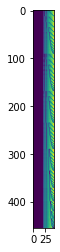

<Figure size 432x288 with 0 Axes>

In [24]:
# quick check all rate matrix
plt.imshow(allRateMatrix_triplet_noncore[:,:])
plt.figure()
# # flip pamat in diagonal and plot it
# plt.imshow(pamat[:,20:34].T)
# # plt.figure()
# # plt.imshow(pamat[:,20:34].T - allRateMatrix[:14,:])
# # plt.colorbar()


In [25]:
# calculate nonCore3 frlist. 

frList_triplet_noncore, nAreaList_triplet_noncore = getNonCoreInhibitionMeanFR(
    allRateMatrix_triplet_noncore, area_list, nonCore, areasIndexShowPA, nonCorePatternList_triplet_noncore)
frList_triplet_noncore

{22: [31.305236966381518, 32.929364554225046, 30.7410778686472, 30.453527311545667, 30.658744775258565, 30.14564774060293, 30.586960940033812, 30.38615291169305, 31.986259543254235, 32.14182803399878, 30.730920626624645, 32.593511425227526, 33.1915217225196, 33.77677152939577, 31.689099012524874, 31.29946138598694, 31.663895307049618, 31.010183831567108, 31.508690115969376, 31.36410367689686, 33.02676949057873, 33.023543133206005, 33.271247311194934, 33.371261031960834, 33.93862687082151, 33.254236884687224, 33.04694484729125, 33.193800854745106, 32.618977722457714, 33.111305759234945, 32.89173988095018, 32.86515005340816, 32.829081285410766, 33.16996504897781, 33.09765342996623, 33.580201454850446, 30.843766030039266, 32.74735636242423, 32.26222455602878, 32.80900763398314, 32.642925089895876, 32.790088907543115, 32.75247805781286, 33.057988136169534, 33.12125248956447, 33.6015648062893, 30.7870574562707, 30.256502892728946, 32.19167539989549, 32.09723351655702, 32.59750918457945, 32.

array([32.5056566 , 31.5852367 , 32.4071342 , 32.58176554, 32.560546  ,
       32.23961418, 32.55341726, 32.17604312, 32.65120251, 32.49398855,
       32.84645264, 32.72298618, 33.02989424, 33.11058256, 33.36559016])

In [26]:
# make plot of frList to check inhibiting which area has greatest effect on firing rate
makePlot2(frList_triplet_noncore, FRDefault,'Average firing rate\n (normalized)', nonCoreAreaList, (5.5,3), 12, False, 'singleAreaLesion/FRchangeInhibition2.svg')
print(frList_triplet_noncore/FRDefault < 0.92)

NameError: name 'makePlot2' is not defined

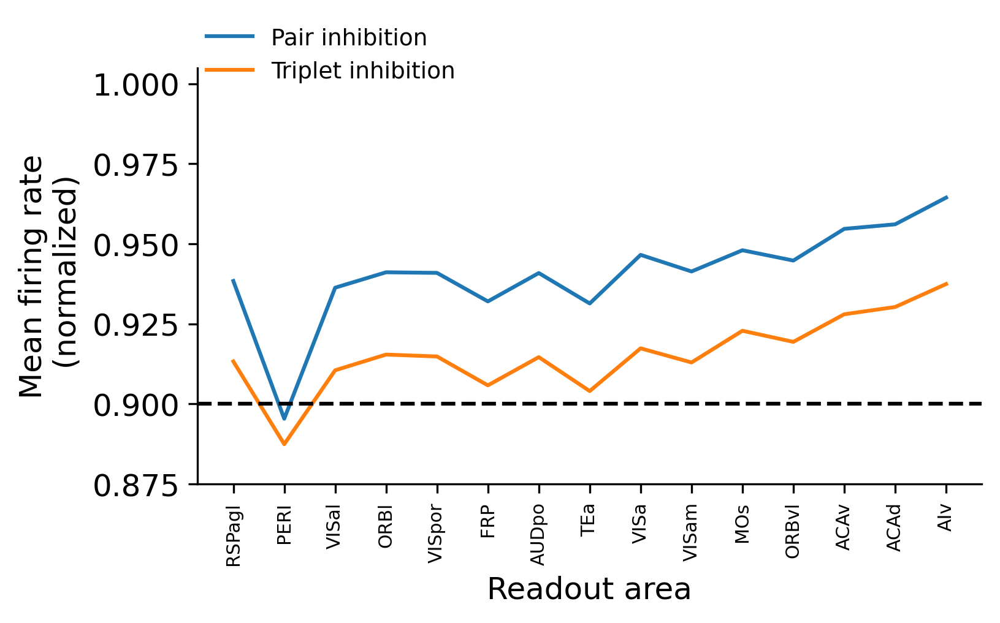

In [27]:
# make a figure consisting of frList_pair_noncore and frList_triplet_noncore

def makePairTriQuadFig(frListList,labelList, FRDefault, Ylabel, area_list, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    for i, frList in enumerate(frListList):
        plt.plot(frList / FRDefault, label = labelList[i])
    plt.xticks(range(len(area_list)), area_list, rotation=90, fontsize=fontSize*0.6)
    plt.xlabel('Readout area')
    plt.ylim([0.875, 1.005])
    plt.axhline(y=0.9, color='k', linestyle='--')
    plt.ylabel(Ylabel)
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    plt.legend(loc='upper left', bbox_to_anchor=(0, 1.12), borderaxespad=0.,  fontsize=fontSize*0.75, frameon=False)
    # save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight', transparent=True)

makePairTriQuadFig([frList_pair_noncore,frList_triplet_noncore], ['Pair inhibition','Triplet inhibition'], 
                   FRDefault,'Mean firing rate\n (normalized)', 
          nonCoreAreaList, (5.5,3), 12, False, 'singleAreaLesion/FRchangeInhibition2.svg')

In [28]:
# define the non-core areas for further inhibition analysis
# nonCore4 = [22, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42]  #newly added PREI, VISal, FRP
nonCorePatternList_quadruplet_noncore = []
for k in [4]:
    nonCorePatternList_quadruplet_noncore += itertools.combinations(nonCore, k)
NnonCorepattern = len(nonCorePatternList_quadruplet_noncore)
print(len(nonCore), len(nonCorePatternList_quadruplet_noncore))
print(nonCorePatternList_quadruplet_noncore[:10])

15 1365
[(22, 23, 25, 27), (22, 23, 25, 32), (22, 23, 25, 33), (22, 23, 25, 34), (22, 23, 25, 35), (22, 23, 25, 36), (22, 23, 25, 37), (22, 23, 25, 38), (22, 23, 25, 39), (22, 23, 25, 40)]


In [29]:
# run simulations with inhibition on multiple non core areas. 

# we dont'  change the parameters. we have same parameters for all simulations. 
# always stimulate v1.
# inhibit differnet aeras in different simulaitons 
# output data is pamat, a matrix of delay activity under each simulation.

# generate stim pattern list 2 3 4 5 6 etc. Focus on the non core areas.
# noncore areas list. 

# init parameters
thcxmodel = False
PAthreshold = 5
savefigflag = False
makeQuickPlot = False

# init results matrix
allRateMatrix_quadruplet_noncore = np.zeros((len(nonCorePatternList_quadruplet_noncore), len(area_list)))

for i, areaTuple in enumerate(nonCorePatternList_quadruplet_noncore):
    stimulatelist = [area_list[i] for i in areaTuple]
    print(stimulatelist)
    current_parameters = copy.copy(parameters)
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    # current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['trial_length'] = 10000 * brian2.ms # trial length (s)
    curModel = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        curModel.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 
        # add delay period inhition
        curModel.add_input(50*current_parameters['stim_strength'], stimulatelist, current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')
        # curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'], current_parameters['trial_length'], 'I')
    curModel.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,_,_] = curModel.save_delay_activity('tempdata/',False)
    persistentact_df =  curModel.generatePAdf(PAthreshold)
    if makeQuickPlot:
        curModel.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        curModel.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

    allRateMatrix_quadruplet_noncore[i, :] = persistentactlist
    # maxBaseMatrixReference[i, ] = np.max(baselineactlistReference)
    # # get the number of elements larger than 5 in persistentactlist
    # numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])


['RSPagl', 'PERI', 'VISal', 'ORBl']
VISp
RSPagl
PERI
VISal
ORBl
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'VISpor']
VISp
RSPagl
PERI
VISal
VISpor
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'FRP']
VISp
RSPagl
PERI
VISal
FRP
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'AUDpo']
VISp
RSPagl
PERI
VISal
AUDpo
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'TEa']
VISp
RSPagl
PERI
VISal
TEa
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'VISa']
VISp
RSPagl
PERI
VISal
VISa
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'VISam']
VISp
RSPagl
PERI
VISal
VISam
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'MOs']
VISp
RSPagl
PERI
VISal
MOs
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'ORBvl']
VISp
RSPagl
PERI
VISal
ORBvl
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'ACAv']
VISp
RSPagl
PERI
VISal
ACAv
simulation start: 
sim done.
['RSPagl', 'PERI', 'VISal', 'ACAd']
VISp
RSPagl
PERI
VISal
ACAd
si

In [30]:
# save and load the results for future use

# np.savetxt('results/allRateMatrix_quadruplet_noncore_inhibit.txt', allRateMatrix_quadruplet_noncore)

allRateMatrix_quadruplet_noncore = np.loadtxt('results/allRateMatrix_quadruplet_noncore_inhibit.txt')
print(allRateMatrix_quadruplet_noncore.shape)

(1365, 43)


In [31]:
# calculate nonCore4 frlist. 
frList_quadruplet_noncore, nAreaList_quadruplet_noncore = getNonCoreInhibitionMeanFR(
    allRateMatrix_quadruplet_noncore, area_list, nonCore,
      areasIndexShowPA, nonCorePatternList_quadruplet_noncore)
frList_quadruplet_noncore

{22: [32.71373628379538, 30.544302031612556, 30.063388410939297, 30.484066109956903, 29.84660138847356, 30.28672647329035, 30.0517008301513, 29.964415386339592, 29.981220778292634, 30.268177297481706, 31.556168770485947, 32.70767351633387, 32.067068805439085, 31.80004146621924, 31.980218876046504, 31.43626032237144, 31.89541189024431, 31.679732370144045, 31.65631356826626, 31.643368044097485, 31.982091330934892, 31.938629977221662, 32.48896649272411, 29.46739753210934, 29.802361604702032, 29.340942170243473, 29.715120277307506, 29.529580863224535, 29.669109920202757, 31.220946696184082, 29.82492134520141, 31.75288989526014, 32.37712274848289, 29.384053049981144, 28.883156194705673, 29.330196689620877, 29.124521715681833, 29.39956585532637, 29.35186942110677, 29.51673347214348, 31.275675954568342, 32.00778540987787, 29.252299905225794, 29.658121239458303, 29.4479053798252, 30.232062709125884, 31.157780098950767, 29.72398524562463, 31.66355803507941, 32.26389713733798, 29.102186446750792

array([31.68043895, 30.96850275, 31.6198348 , 31.71139094, 31.7088757 ,
       31.41832031, 31.68555397, 31.33779167, 31.73822466, 31.59738487,
       31.92037664, 31.81544064, 32.08834534, 32.1990732 , 32.37624579])

[False False False False False False False False False False False False
 False False False False False False False False False False  True  True
 False  True False  True False False False False  True  True  True  True
  True  True  True  True  True  True False]


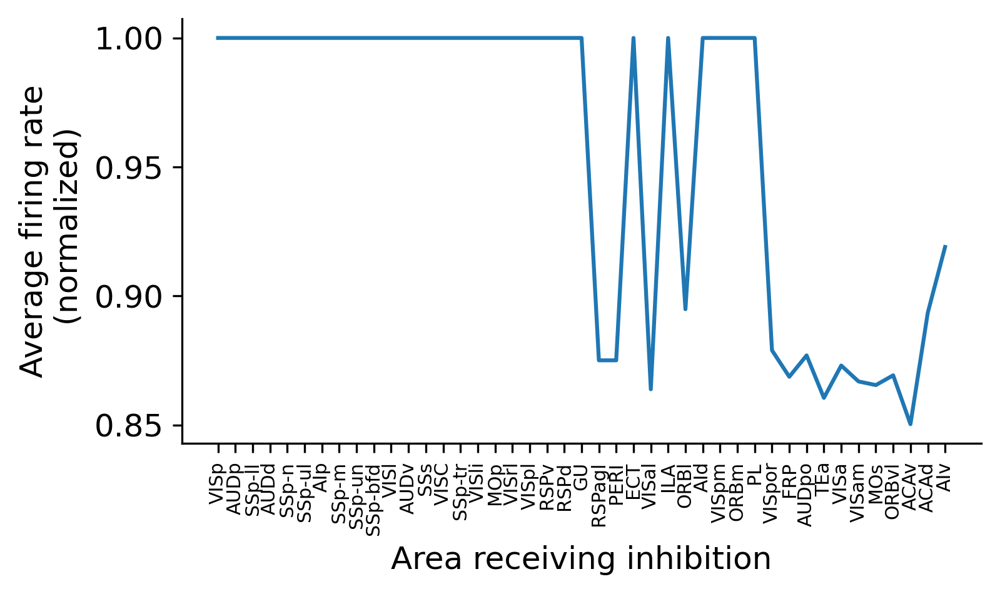

In [165]:
# make plot of frList to check inhibiting which area has greatest effect on firing rate
makePlot2(frList4, FRDefault,'Average firing rate\n (normalized)', area_list, (5.5,3), 12, False, 'singleAreaLesion/FRchangeInhibition2.svg')
print(frList4/FRDefault < 0.9)


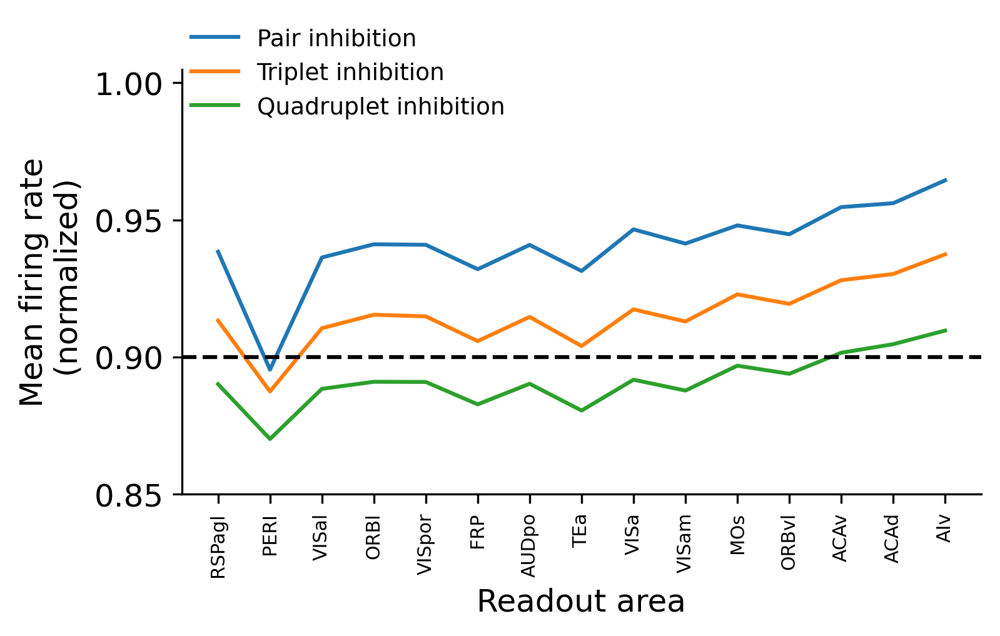

In [33]:
# make a figure consisting of frList_pair_noncore and frList_triplet_noncore

def makePairTriQuadFig(frListList,labelList, FRDefault, Ylabel, area_list, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    for i, frList in enumerate(frListList):
        plt.plot(frList / FRDefault, label = labelList[i])
    plt.xticks(range(len(area_list)), area_list, rotation=90, fontsize=fontSize*0.6)
    plt.xlabel('Readout area')
    plt.ylim([0.85, 1.005])
    plt.axhline(y=0.9, color='k', linestyle='--')
    plt.ylabel(Ylabel)
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    plt.legend(loc='upper left', bbox_to_anchor=(0, 1.12), borderaxespad=0.,  fontsize=fontSize*0.75, frameon=False)
    # save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight', transparent=True)

makePairTriQuadFig([frList_pair_noncore,frList_triplet_noncore, frList_quadruplet_noncore], 
                   ['Pair inhibition','Triplet inhibition','Quadruplet inhibition'], 
                   FRDefault,'Mean firing rate\n (normalized)', 
          nonCoreAreaList, (5.5,3), 12, False, 'singleAreaLesion/FRchangeInhibition2.svg')

[22, 23, 25, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42]

In [42]:
# compare the pair of cores vs pair of non-cores and core-noncore pair
# run simulations with inhibition on pair of core areas. 

PatternList_pair_core = []
for k in [2]:
    PatternList_pair_core += itertools.combinations(core, k)
NnonCorepattern = len(PatternList_pair_core)
print(len(core), len(PatternList_pair_core))
print(PatternList_pair_core[:10])

# init parameters
thcxmodel = False
PAthreshold = 5
savefigflag = False
makeQuickPlot = False

# init results matrix
allRateMatrix_pair_core = np.zeros((len(PatternList_pair_core), len(area_list)))

for i, areaTuple in enumerate(PatternList_pair_core):
    stimulatelist = [area_list[i] for i in areaTuple]
    print(stimulatelist)
    current_parameters = copy.copy(parameters)
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    # current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['trial_length'] = 10000 * brian2.ms # trial length (s)
    curModel = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        curModel.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 
        # add delay period inhition
        curModel.add_input(50*current_parameters['stim_strength'], stimulatelist, current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')
        # curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'], current_parameters['trial_length'], 'I')
    curModel.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,_,_] = curModel.save_delay_activity('tempdata/',False)
    persistentact_df =  curModel.generatePAdf(PAthreshold)
    if makeQuickPlot:
        curModel.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        curModel.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

    allRateMatrix_pair_core[i, :] = persistentactlist
    # maxBaseMatrixReference[i, ] = np.max(baselineactlistReference)
    # # get the number of elements larger than 5 in persistentactlist
    # numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])


7 21
[(21, 24), (21, 26), (21, 28), (21, 29), (21, 30), (21, 31), (24, 26), (24, 28), (24, 29), (24, 30)]
['GU', 'ECT']
VISp
GU
ECT
simulation start: 
sim done.
['GU', 'ILA']
VISp
GU
ILA
simulation start: 
sim done.
['GU', 'AId']
VISp
GU
AId
simulation start: 
sim done.
['GU', 'VISpm']
VISp
GU
VISpm
simulation start: 
sim done.
['GU', 'ORBm']
VISp
GU
ORBm
simulation start: 
sim done.
['GU', 'PL']
VISp
GU
PL
simulation start: 
sim done.
['ECT', 'ILA']
VISp
ECT
ILA
simulation start: 
sim done.
['ECT', 'AId']
VISp
ECT
AId
simulation start: 
sim done.
['ECT', 'VISpm']
VISp
ECT
VISpm
simulation start: 
sim done.
['ECT', 'ORBm']
VISp
ECT
ORBm
simulation start: 
sim done.
['ECT', 'PL']
VISp
ECT
PL
simulation start: 
sim done.
['ILA', 'AId']
VISp
ILA
AId
simulation start: 
sim done.
['ILA', 'VISpm']
VISp
ILA
VISpm
simulation start: 
sim done.
['ILA', 'ORBm']
VISp
ILA
ORBm
simulation start: 
sim done.
['ILA', 'PL']
VISp
ILA
PL
simulation start: 
sim done.
['AId', 'VISpm']
VISp
AId
VISpm
simulat

In [44]:
# save and load the results for future use

# np.savetxt('results/allRateMatrix_pair_core_inhibit.txt', allRateMatrix_pair_core)

allRateMatrix_pair_core = np.loadtxt('results/allRateMatrix_pair_core_inhibit.txt')
print(allRateMatrix_pair_core.shape)

(21, 43)


In [45]:
# compare the pair of core-noncore pair

PatternList_pair_core_noncore = []
for i in core:
    for j in nonCore:
        PatternList_pair_core_noncore.append((i,j))
NnonCorepattern = len(PatternList_pair_core_noncore)
print(len(core), len(PatternList_pair_core_noncore))
print(PatternList_pair_core_noncore[:10])

# init parameters
thcxmodel = False
PAthreshold = 5
savefigflag = False
makeQuickPlot = False

# init results matrix
allRateMatrix_pair_core_noncore = np.zeros((len(PatternList_pair_core_noncore), len(area_list)))

for i, areaTuple in enumerate(PatternList_pair_core_noncore):
    stimulatelist = [area_list[i] for i in areaTuple]
    print(stimulatelist)
    current_parameters = copy.copy(parameters)
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    # current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['trial_length'] = 10000 * brian2.ms # trial length (s)
    curModel = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        curModel.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 
        # add delay period inhition
        curModel.add_input(50*current_parameters['stim_strength'], stimulatelist, current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')
        # curModel.add_input(50*current_parameters['stim_strength'], list(areaTuple), current_parameters['stim_off'], current_parameters['trial_length'], 'I')
    curModel.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,_,_] = curModel.save_delay_activity('tempdata/',False)
    persistentact_df =  curModel.generatePAdf(PAthreshold)
    if makeQuickPlot:
        curModel.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        curModel.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

    allRateMatrix_pair_core_noncore[i, :] = persistentactlist
    # maxBaseMatrixReference[i, ] = np.max(baselineactlistReference)
    # # get the number of elements larger than 5 in persistentactlist
    # numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])



7 105
[(21, 22), (21, 23), (21, 25), (21, 27), (21, 32), (21, 33), (21, 34), (21, 35), (21, 36), (21, 37)]
['GU', 'RSPagl']
VISp
GU
RSPagl
simulation start: 
sim done.
['GU', 'PERI']
VISp
GU
PERI
simulation start: 
sim done.
['GU', 'VISal']
VISp
GU
VISal
simulation start: 
sim done.
['GU', 'ORBl']
VISp
GU
ORBl
simulation start: 
sim done.
['GU', 'VISpor']
VISp
GU
VISpor
simulation start: 
sim done.
['GU', 'FRP']
VISp
GU
FRP
simulation start: 
sim done.
['GU', 'AUDpo']
VISp
GU
AUDpo
simulation start: 
sim done.
['GU', 'TEa']
VISp
GU
TEa
simulation start: 
sim done.
['GU', 'VISa']
VISp
GU
VISa
simulation start: 
sim done.
['GU', 'VISam']
VISp
GU
VISam
simulation start: 
sim done.
['GU', 'MOs']
VISp
GU
MOs
simulation start: 
sim done.
['GU', 'ORBvl']
VISp
GU
ORBvl
simulation start: 
sim done.
['GU', 'ACAv']
VISp
GU
ACAv
simulation start: 
sim done.
['GU', 'ACAd']
VISp
GU
ACAd
simulation start: 
sim done.
['GU', 'AIv']
VISp
GU
AIv
simulation start: 
sim done.
['ECT', 'RSPagl']
VISp
ECT
RSP

In [47]:
# save and load the results for future use

# np.savetxt('results/allRateMatrix_pair_core_noncore_inhibit.txt', allRateMatrix_pair_core_noncore)

allRateMatrix_pair_core_noncore = np.loadtxt('results/allRateMatrix_pair_core_noncore_inhibit.txt')
print(allRateMatrix_pair_core_noncore.shape)

(105, 43)


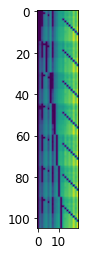

In [53]:
allRateMatrix_pair_core, allRateMatrix_pair_noncore, allRateMatrix_pair_core_noncore
plt.imshow(allRateMatrix_pair_core_noncore[:,20:40])

NameError: name 'coreAreaList' is not defined

In [71]:

np.mean(np.sum(allRateMatrix_pair_core_noncore[:,21:43], axis=1)/(43-21-2))

31.163263852826574

In [80]:
# calculate the decrement of firing rate when all core areas are inhibited. 
# FRDefault = float(np.loadtxt('results/FRdefault.csv', delimiter=","))
with open('results/model_V1_allcore.pkl', 'rb') as f:
    modelAllcore = pickle.load(f)
dec_allcore = np.sum(modelAllcore.persistentact_df['persistentact'][21:43]) / (43-21-7) / FRDefault
print(FRDefault, dec_allcore)

35.59243264286996 0.5252476979797357


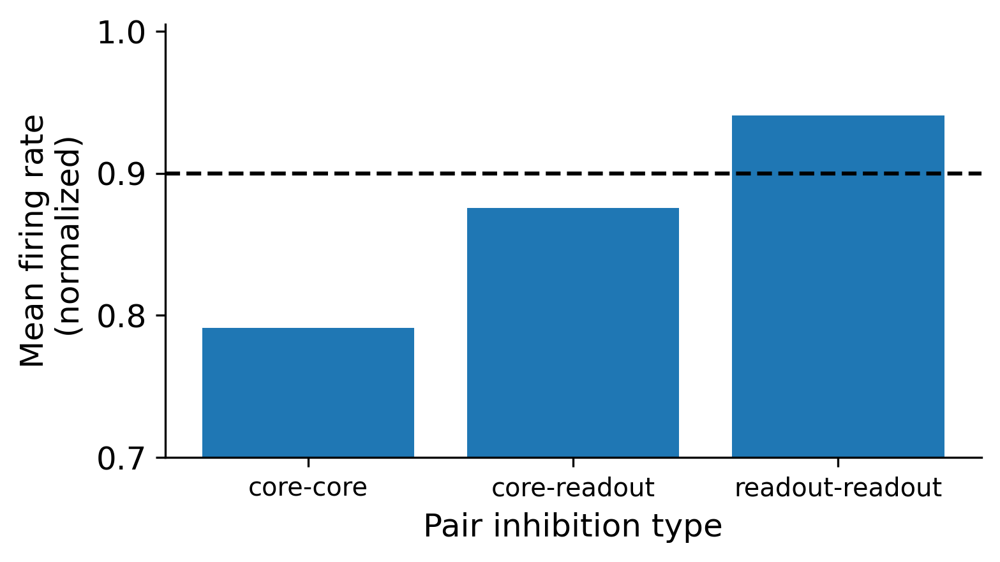

In [77]:

# make a bar plot of the dec of core, noncore and core-noncore
def makeBarcorenoncorepair(allRateMatrix_pair_core,allRateMatrix_pair_noncore, allRateMatrix_pair_core_noncore,
                           FRDefault, Xlabel, Ylabel, area_list, figureSize, fontSize, saveFig, fileName):
    dec_core_noncore = np.mean(np.sum(allRateMatrix_pair_core_noncore[:,21:43], axis=1)/(43-21-2))/FRDefault
    # std_core_noncore = np.std(allRateMatrix_pair_core_noncore[:,21:43])
    dec_core = np.mean(np.sum(allRateMatrix_pair_core[:,21:43], axis=1)/(43-21-2))/FRDefault
    # std_core = np.std(allRateMatrix_pair_core[:,21:43])
    dec_noncore = np.mean(np.sum(allRateMatrix_pair_noncore[:,21:43], axis=1)/(43-21-2))/FRDefault
    # std_noncore = np.std(allRateMatrix_pair_noncore[:,21:43])

    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    # plt.bar([0,1,2], [dec_core,  dec_core_noncore, dec_noncore], yerr = [std_core, std_core_noncore, std_noncore])
    plt.bar([0,1,2], [dec_core,  dec_core_noncore, dec_noncore])
    plt.xticks(range(3), ['core-core', 'core-readout', 'readout-readout'], rotation=0, fontsize=fontSize*0.8)
    plt.ylim([0.7, 1.005])
    plt.axhline(y=0.9, color='k', linestyle='--')
    plt.xlabel(Xlabel)
    plt.ylabel(Ylabel)
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    # save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight', transparent=True)

makeBarcorenoncorepair( allRateMatrix_pair_core,allRateMatrix_pair_noncore, allRateMatrix_pair_core_noncore,
                   FRDefault, 'Pair inhibition type','Mean firing rate\n (normalized)', 
          area_list, (5.5,3), 12, False, 'singleAreaLesion/barCoreNoncorePair.svg')


In [133]:
# # open the stim pattern list for following analysis 
# with open('results/stimPatternList.json','r') as f:
#     stimPatternList = json.load(f)
# npattern = len(stimPatternList)
# print(npattern)
# stimPatternList[:5]

In [32]:
# load data and plot attractor firing rate.  single area receive stimulation.
n_areas = len(area_list)
pamat = np.zeros((n_areas, npattern))
nsize = 80
filepath = '.'
njobs = int(npattern/nsize) + 1
# folderName = 'results22Jun16_0'  ## delay inhibition for (0.1, 0.44)
folderName = 'results22May17_2' ## delay inhbition for default params
fullFolderName = filepath + '/tempdata/' + folderName
for i in range(njobs):
    stimList = stimPatternList[i * nsize: (i + 1) * nsize]
    loadfilename = fullFolderName + '/att_' + str(i) + '_' + str(nsize) + '.txt'
    if Path(loadfilename).is_file():
        with open(loadfilename, 'r') as f:
            panew = json.load(f)
        pamat[:, i * nsize : (i + 1) * nsize] = np.array(panew).T
    else:
        print('error load file ' + loadfilename)
sortedPamat = pamat     

In [33]:
def makePlot(pamat, areasShowPA, area_list, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    n_areas = len(area_list)
    n_areasShowPA = len(areasShowPA) + 2 # add two to show the area without firing
    plt.imshow(pamat[-n_areasShowPA:, :n_areas])
    plt.xticks(range(n_areas), area_list, rotation = 90, fontsize=fontSize*0.6)
    
    plt.yticks(range(n_areas)[:n_areasShowPA], area_list[-n_areasShowPA:], fontsize = fontSize*0.6)
    
    plt.xlabel('Area receiving inhibition')
    plt.ylabel('Area')
    
    # plt.title('Firing rate under inhibition')
    cbar = plt.colorbar()
    cbar.set_label('Firing rate (Hz)')
    # save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight', transparent=True)
    # plt.savefig('figure/neurondensity_grad.png', dpi=80, bbox_inc)

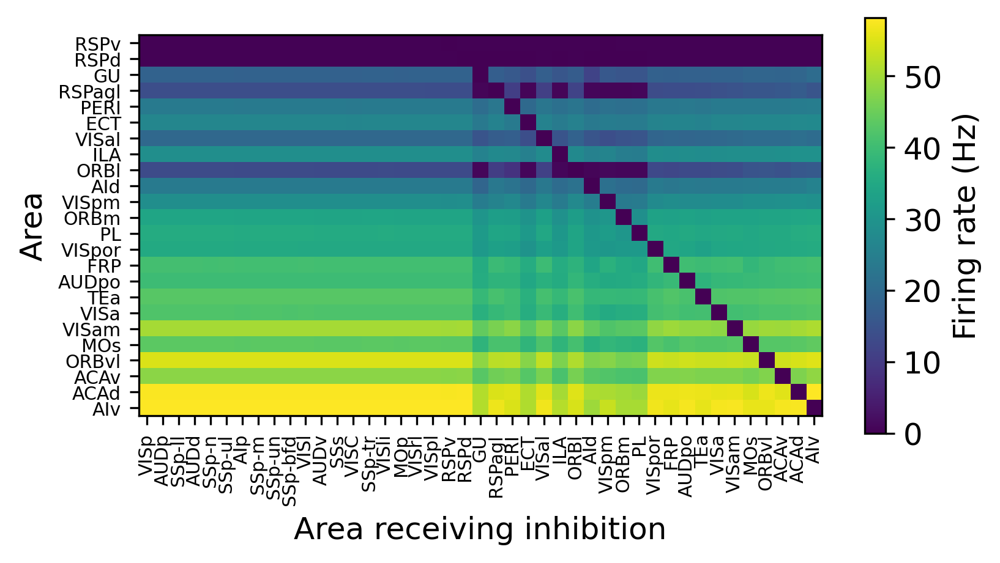

In [35]:
pamat = allRateMatrix.T
makePlot(pamat, areasShowPA, area_list, (6,3), 12, True, 'singleAreaLesion/FRchangeInhibition.svg')

In [36]:
# # quantify inhibiting any area => average FR change and # area change.
# countAreaAIv = 0
# frInhibitArea = np.zeros(len(stimAreaList))
# print(frInhibitArea, len(frInhibitArea))
# numInhAreaList = [1, 2]
# for i in range(len(stimPatternList)):
#     stimP = stimPatternList[i]
#     nAreaStim = len(stimP)
#     if nAreaStim in numInhAreaList:
#         continue
#     pa = sortedPamat[:, i]
#     fr = np.sum(pa[:22])/(22 - nAreaStim)
    
#     for i in range(nAreaStim):
#         indexStimArea = stimAreaList.index(stimP[i])
#         if stimP[i] == 'AIv':
#             countAreaAIv += 1
#         frInhibitArea[indexStimArea] += fr
# frInhibitArea /= countAreaAIv
# frInhibitArea



In [37]:
# pa = [0.0000000e+00,5.8061826e+01,4.8352514e+01,5.5244732e+01,4.3760025e+01,5.0918533e+01,4.2480888e+01,4.3395737e+01,4.0273699e+01,4.0999348e+01,3.5578776e+01,3.6232181e+01,3.4635422e+01,2.9213208e+01,2.5832792e+01,1.6486855e+01,2.9414571e+01,2.0387745e+01,2.7598671e+01,2.4688095e+01,1.5260067e+01,2.0584856e+01,2.7722700e-01,3.0624600e-01,4.0367200e-01,3.1274800e-01,2.1449000e-01,1.5396200e-01,1.5442500e-01,5.9376200e-01,1.3519100e-01,2.7808300e-01,5.2943000e-02,4.0537000e-02,2.8089000e-02,4.7664000e-02,3.8491200e-01,1.3058000e-02,2.2335000e-02,1.7416000e-02,7.4230000e-03,1.5749000e-02,7.4800000e-04]

In [15]:
def procSingleSim(pa, area_list, areasShowPA, stimP, threshold):
    # calculate the firing rate of areas show PA and not get inhibited. 
    n = len(pa)
    ROI = []
    for i in range(n):
        area = area_list[i]
        if area in areasShowPA and area not in stimP:
            ROI.append(pa[i])
#             print(area, i, pa[i])
    ROI = np.array(ROI)
    return np.mean(ROI), sum(ROI > threshold)

In [16]:
def getMeanFR(pamat, area_list, areasShowPA, stimPatternList, numInhAreaList):
    countAreaAIv = 0
    frInhibitArea = np.zeros(len(area_list))
    frList = []
    nAreaList = []
    for i in range(len(stimPatternList)):
        stimP = stimPatternList[i]
        nAreaStim = len(stimP) # number of areas receive stimulation
        if nAreaStim not in numInhAreaList: # only focus on the stim pattern with given number of areas.
            continue
        pa = pamat[:, i]
        
        fr, nAreaPA = procSingleSim(pa, area_list, areasShowPA, stimP, 5)
        frList.append(fr)
        nAreaList.append(nAreaPA)
#         fr = 0
#         frArea = 0
#         for k in range(len(AreaList)):

#         fr = np.sum(pa[:22])/(22 - nAreaStim) # mean FR of areas showing PA (exclude those inhibited.)        
#         for j in range(nAreaStim):
#             indexStimArea = AreaList.index(stimP[j])
#             if stimP[j] == 'AIv':
#                 countAreaAIv += 1
#             frInhibitArea[indexStimArea] += fr
    
#     frInhibitArea /= countAreaAIv
    
    return np.array(frList), np.array(nAreaList)
    

In [17]:
plt.imshow(pamat)

NameError: name 'pamat' is not defined

In [41]:
nAreaList

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0, 21, 14, 21, 21, 21, 21, 14, 21, 21, 21, 21, 21, 21,
       21, 21, 21, 21, 21, 21, 21, 21, 21])

In [18]:
# frList, nAreaList = getMeanFR(pamat, AreaList, areasShowPA, stimPatternList, [1])
frList, nAreaList = getMeanFR(pamat, area_list, areasShowPA, stimPatternList, [1])

NameError: name 'pamat' is not defined

In [50]:
# frListdefault = [ model_V1.persistentact_df['persistentact'][k] for k in np.argsort(hierlist)][::-1]
frListdefault = model_V1.persistentact_df['persistentact']
FRDefault, numberAreaDefault = procSingleSim(frListdefault, area_list, areasShowPA, [], 5)
print(FRDefault,numberAreaDefault)
np.savetxt('results/FRdefault.csv', [FRDefault], delimiter=",", fmt = '%s')

35.59243264286996


In [44]:
def makePlot2(frList, FRDefault, Ylabel, area_list, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
        
    plt.plot(frList / FRDefault)
    plt.xticks(range(len(area_list)), area_list, rotation=90, fontsize=fontSize*0.6)
    plt.xlabel('Area receiving inhibition')
    # plt.grid('on')
    plt.ylabel(Ylabel)
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    # save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight',transparent=True)
    # plt.savefig('figure/neurondensity_grad.png',dpi=80,bbox_inc

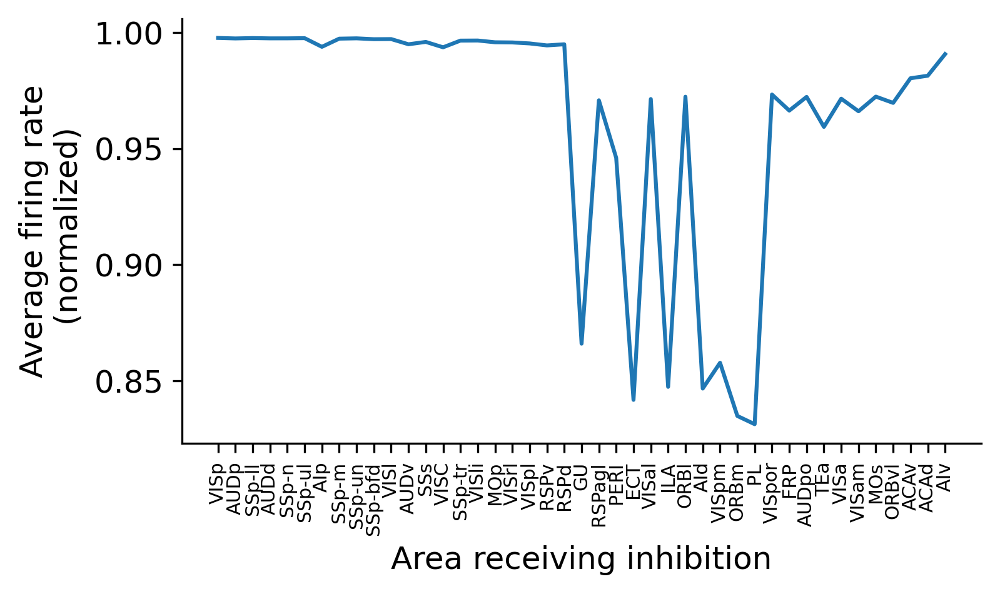

In [45]:
# reverse the frList
makePlot2(frList, FRDefault,'Average firing rate\n (normalized)', area_list, (5.5,3), 12, True, 'singleAreaLesion/FRchangeInhibition2.svg')

In [77]:
## deprecated code  
# makePlot2(frList[1:], FRDefault,'Average firing rate', area_list[1:], (5,3), 12, True, 'singleAreaLesion/FRchangeInhibition3.svg')
# print(FRDefault)

In [78]:
# # specific look at PL firing rate
# FR_PL_List = pamat[31,:n_areas]
# FR_PL_default = frListdefault[31]
# makePlot2(FR_PL_List, FR_PL_default, 'average firing rate',area_list,(5,3), 12, False, 'singleAreaLesion/FR3.svg')
# print(FR_PL_default)

In [79]:
# # specific look at ILA firing rate
# FR_ILA_List = pamat[26,:n_areas]
# FR_ILA_default = frListdefault[26]
# makePlot2(FR_ILA_List, FR_ILA_default, 'average firing rate',area_list,(5,3), 12, False, 'singleAreaLesion/FR3.svg')
# print(FR_ILA_default)

In [80]:
# # number of areas show PA under different inhibition patterns.
# makePlot2(nAreaList[1:], 1, 'areas with persistent activity',area_list[1:], (5,3), 12, False, 'singleAreaLesion/FRchangeInhibition3.svg')

In [46]:
# np.savetxt('results/FRStimInhibition.csv', frList, delimiter=",", fmt = '%s')
np.savetxt('results/FRDelayInhibition.csv', frList, delimiter=",", fmt = '%s')


In [11]:
# mm22  start by load the data from the simulation results.
StimInhfrList = np.loadtxt('results/FRStimInhibition.csv', delimiter=',')  # we got this stimulus inhibition simulation result from a different simulation.
DelayInhfrList = np.loadtxt('results/FRDelayInhibition.csv', delimiter=',')

frListdefault = model_V1.persistentact_df['persistentact']
FRDefault = np.loadtxt('results/FRdefault.csv', delimiter=",")


In [12]:
# print(frListdefault)
print(FRDefault)

35.59243264286996


In [13]:
def getCategory(StimInhfrList, DelayInhfrList, frListdefault, FRDefault, area_list):
    stimEffect = 1 - StimInhfrList / FRDefault
    delayEffect = 1 - DelayInhfrList / FRDefault
    
    categoryList = []
    for i in range(len(area_list)):
        if stimEffect[i] > 0.5 and delayEffect[i] < 0.5:
            categoryList += ['input'] # input
        elif stimEffect[i] < 0.5 and delayEffect[i] > 0.1 and frListdefault[i] > 5:
            categoryList += ['core'] # core
        elif stimEffect[i] < 0.5 and delayEffect[i] < 0.1 and frListdefault[i] > 5:
            categoryList += ['sustain'] # readout
        else:
            categoryList += ['irrelavent'] # irrelavent
    
    return categoryList

In [14]:
categoryList = getCategory(StimInhfrList, DelayInhfrList, frListdefault, FRDefault, area_list)

In [15]:
# # use kmeans to cluster the areas 
# import pandas as pd
# import numpy as np
# import matplotlib.pyplot as plt
# from sklearn.cluster import KMeans
# import random

# random.seed(10)
# print(random.random())
# # colorpalatte
# # #e41a1c
# # #377eb8
# # #4daf4a
# # #984ea3

# # colorpalatte
# # #66c2a5
# # #fc8d62
# # #8da0cb
# # #e78ac3

# # def getCategoryKmeans(StimInhfrList, DelayInhfrList, frListdefault, FRDefault, area_list):
# #     stimEffect = 1 - StimInhfrList / FRDefault
# #     delayEffect = 1 - DelayInhfrList / FRDefault

# #     stimNorm = stimEffect / np.max(stimEffect)
# #     delayNorm = delayEffect / np.max(delayEffect)
# #     frNorm = frListdefault / np.max(frListdefault)

# #     X = np.zeros((len(area_list), 3))
# #     X[:, 0] = stimNorm
# #     X[:, 1] = delayNorm
# #     X[:, 2] = frNorm
# # #     print(X)
# #     KmeanModel = KMeans(n_clusters=4)
# #     KmeanModel.fit(X)

# #     lab = KmeanModel.labels_
# # #     print(lab)
# #     labelMap = {}

# #     inputAreaExample = np.argsort(stimNorm)[::-1][0]
# #     labelMap[lab[inputAreaExample]] = 'input'

# #     coreAreaExample = np.argsort(delayNorm)[::-1][0]
# # #     print(coreAreaExample)
# #     labelMap[lab[coreAreaExample]] = 'core'

# #     i = len(area_list) - 1
# #     while i >= 0:
# #         if frListdefault[i] > 5:
# #             if lab[i] not in labelMap:
# #                 labelMap[lab[i]] = 'readout'
# #                 break
# #         i -= 1
# #     if i < 0:
# #         labelMap[3] = 'readout'

# #     for k in [0, 1, 2, 3]:
# #         if k not in labelMap:
# #             labelMap[k] = 'exterior'

# #     return [labelMap[x] for x in lab]

In [16]:
# def getCategoryKmeans1D(StimInhfrList, DelayInhfrList, frListdefault, FRDefault, area_list):
#     stimEffect = 1 - StimInhfrList / FRDefault
#     delayEffect = 1 - DelayInhfrList / FRDefault

#     stimNorm = stimEffect / np.max(stimEffect)
#     delayNorm = delayEffect / np.max(delayEffect)
#     frNorm = frListdefault / np.max(frListdefault)

#     X = np.zeros((len(area_list), 3))
#     X[:, 0] = stimNorm
#     X[:, 1] = delayNorm
#     X[:, 2] = frNorm
# #     print(X)
#     KmeanModel = KMeans(n_clusters=4)
#     KmeanModel.fit(X)

#     lab = KmeanModel.labels_
# #     print(lab)
#     labelMap = {}

#     inputAreaExample = np.argsort(stimNorm)[::-1][0]
#     labelMap[lab[inputAreaExample]] = 'input'

#     coreAreaExample = np.argsort(delayNorm)[::-1][0]
# #     print(coreAreaExample)
#     labelMap[lab[coreAreaExample]] = 'core'

#     i = len(area_list) - 1
#     while i >= 0:
#         if frListdefault[i] > 5:
#             if lab[i] not in labelMap:
#                 labelMap[lab[i]] = 'readout'
#                 break
#         i -= 1
#     if i < 0:
#         labelMap[3] = 'readout'

#     for k in [0, 1, 2, 3]:
#         if k not in labelMap:
#             labelMap[k] = 'exterior'

#     return [labelMap[x] for x in lab]

In [17]:
# categoryList = getCategoryKmeans(StimInhfrList, DelayInhfrList, frListdefault, FRDefault, area_list)

In [18]:
print(categoryList)
# save categoryList
with open('results/categoryList.json', 'w') as f:
    json.dump(list(categoryList), f)

['input', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'irrelavent', 'core', 'sustain', 'sustain', 'core', 'sustain', 'core', 'sustain', 'core', 'core', 'core', 'core', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain', 'sustain']


In [19]:
print([(s,z) for s,z in zip(categoryList, area_list)])

[('input', 'VISp'), ('irrelavent', 'AUDp'), ('irrelavent', 'SSp-ll'), ('irrelavent', 'AUDd'), ('irrelavent', 'SSp-n'), ('irrelavent', 'SSp-ul'), ('irrelavent', 'AIp'), ('irrelavent', 'SSp-m'), ('irrelavent', 'SSp-un'), ('irrelavent', 'SSp-bfd'), ('irrelavent', 'VISl'), ('irrelavent', 'AUDv'), ('irrelavent', 'SSs'), ('irrelavent', 'VISC'), ('irrelavent', 'SSp-tr'), ('irrelavent', 'VISli'), ('irrelavent', 'MOp'), ('irrelavent', 'VISrl'), ('irrelavent', 'VISpl'), ('irrelavent', 'RSPv'), ('irrelavent', 'RSPd'), ('core', 'GU'), ('sustain', 'RSPagl'), ('sustain', 'PERI'), ('core', 'ECT'), ('sustain', 'VISal'), ('core', 'ILA'), ('sustain', 'ORBl'), ('core', 'AId'), ('core', 'VISpm'), ('core', 'ORBm'), ('core', 'PL'), ('sustain', 'VISpor'), ('sustain', 'FRP'), ('sustain', 'AUDpo'), ('sustain', 'TEa'), ('sustain', 'VISa'), ('sustain', 'VISam'), ('sustain', 'MOs'), ('sustain', 'ORBvl'), ('sustain', 'ACAv'), ('sustain', 'ACAd'), ('sustain', 'AIv')]


In [20]:
noLabelAreas = ['AIv','ACAd','ORBvl','VISam','VISa','TEa','AUDpo','FRP','VISpor', 'RSPagl', 'ORBl', 'VISal',
               'RSPd','RSPv','VISpl','VISrl','MOp','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-bfd','SSp-un','SSp-m','AIp','SSp-ul','SSp-n','AUDd','SSp-ll','AUDp']
# 'SSp-ll','SSp-ul','SSp-n','SSp-m','SSp-tr','VISli','VISpl','VISrl','RSPd','AUDv',

In [21]:
def plotStimDelayInhibition(StimInhfrList, DelayInhfrList, categoryList, frListdefault, FRDefault, area_list,noLabelAreas, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    
    stimEffect = 1 - StimInhfrList / FRDefault
    delayEffect = 1 - DelayInhfrList / FRDefault
    cList = []
    texts = []
    xPos = []
    yPos = []
    ax = plt.gca()    
    for i in range(len(area_list)):
        if categoryList[i] == 'input':
            cList += ['#e41a1c'] # input
        elif categoryList[i] == 'core':
            cList += ['#377eb8'] # core
        elif categoryList[i] == 'sustain':
            cList += ['#4daf4a'] # readout
        else:
            cList += ['#984ea3'] # exterior
        acr = area_list[i]
        x = stimEffect[i]
        y = delayEffect[i]
        if acr not in noLabelAreas:
            xPos += [x]
            yPos += [y]
            texts += [ax.text(x, y, acr, c='k',fontsize=fontSize*0.4)]

    plt.scatter(stimEffect, delayEffect, c=cList, alpha=0.5)

    adjust_text(texts, xPos, yPos,
                        ax=ax, precision=0.001,
                        arrowprops=dict(arrowstyle='-', color='gray', alpha=.8))
    
    plt.xlabel('Inactivation effect (stimulus)')
    plt.ylabel('Inactivation effect (delay)')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
# save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight',transparent=True)
    # plt.savefig('figure/neurondensity_grad.png',dpi=80,bbox_inc
    

In [22]:
# def plotStimDelayInhibition(StimInhfrList, DelayInhfrList, frListdefault, FRDefault, area_list, figureSize, fontSize, saveFig, fileName):
#     fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
#     plt.rcParams.update({'font.size': fontSize})
    
# #     stimEffect = 1 - StimInhfrList[i] / FRDefault
# #     delayEffect = 1 - DelayInhfrList[i] / FRDefault
# #     cList = []
#     for i in range(len(area_list)):
#         stimEffect = 1 - StimInhfrList[i] / FRDefault
#         delayEffect = 1 - DelayInhfrList[i] / FRDefault
#         if stimEffect > 0.5 and delayEffect < 0.5:
#             c = '#e41a1c' # input
#         elif stimEffect < 0.5 and delayEffect > 0.05 and frListdefault[i] > 5:
#             c = '#377eb8' # core
#         elif stimEffect < 0.5 and delayEffect < 0.05 and frListdefault[i] > 5:
#             c = '#4daf4a' # readout
#         else:
#             c = '#984ea3' # irrelavent

#     plt.scatter(stimEffect, delayEffect, c=c, alpha=0.7)

#     plt.xlabel('Lesion effect(stim)')
#     plt.ylabel('Lesion effect(delay)')
#     ax = plt.gca()
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
# # save figure
#     if saveFig:
#         plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight',transparent=True)
#     # plt.savefig('figure/neurondensity_grad.png',dpi=80,bbox_inc
    

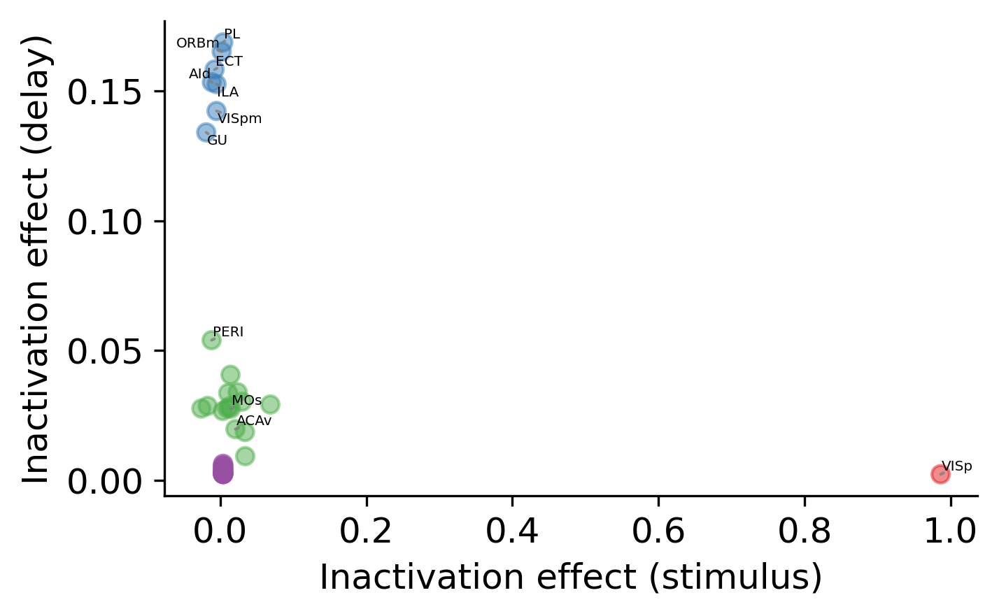

In [23]:
plotStimDelayInhibition(StimInhfrList, DelayInhfrList, categoryList, frListdefault, FRDefault, area_list, noLabelAreas, (5,3), 12, True, 'singleAreaLesion/stimdelayFRchangeInhibition.svg')

In [24]:
noLabelAreas2 = ['RSPd','RSPv','VISpl','VISrl','MOp','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-bfd','SSp-un','SSp-m','AIp','SSp-ul','SSp-n','AUDd','SSp-ll','AUDp']
# 'SSp-ll','SSp-ul','SSp-n','SSp-m','SSp-tr','VISli','VISpl','VISrl','RSPd','AUDv',

In [25]:
def plotDelayInhibitionAndDefault(StimInhfrList, DelayInhfrList, categoryList, frListdefault, FRDefault, area_list, noLabelAreas, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    
    stimEffect = 1 - StimInhfrList / FRDefault
    delayEffect = 1 - DelayInhfrList / FRDefault
    cList = []
    texts = []
    xPos = []
    yPos = []
    ax = plt.gca()    
    for i in range(len(area_list)):
        if categoryList[i] == 'input':
            cList += ['#e41a1c'] # input
        elif categoryList[i] == 'core':
            cList += ['#377eb8'] # core
        elif categoryList[i] == 'sustain':
            cList += ['#4daf4a'] # readout
        else:
            cList += ['#984ea3'] # exterior
        acr = area_list[i]
        x = frListdefault[i]
        y = delayEffect[i]
        if acr not in noLabelAreas:
            xPos += [x]
            yPos += [y]
            texts += [ax.text(x, y, acr, c='k',fontsize=fontSize*0.4)]
    
    plt.scatter(frListdefault, delayEffect, c=cList, alpha=0.5)
    plt.scatter(frListdefault[0], delayEffect[0], c=cList[0], alpha=0.5) # make VISp show up
    
    adjust_text(texts, xPos, yPos,
                        ax=ax, precision=0.001,
                        arrowprops=dict(arrowstyle='-', color='gray', alpha=.8))
    
    plt.xlabel('Delay period firing rate (Hz)')
    plt.ylabel('Inactivation effect (delay)')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
# save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight',transparent=True)
    # plt.savefig('figure/neurondensity_grad.png',dpi=80,bbox_inc
    

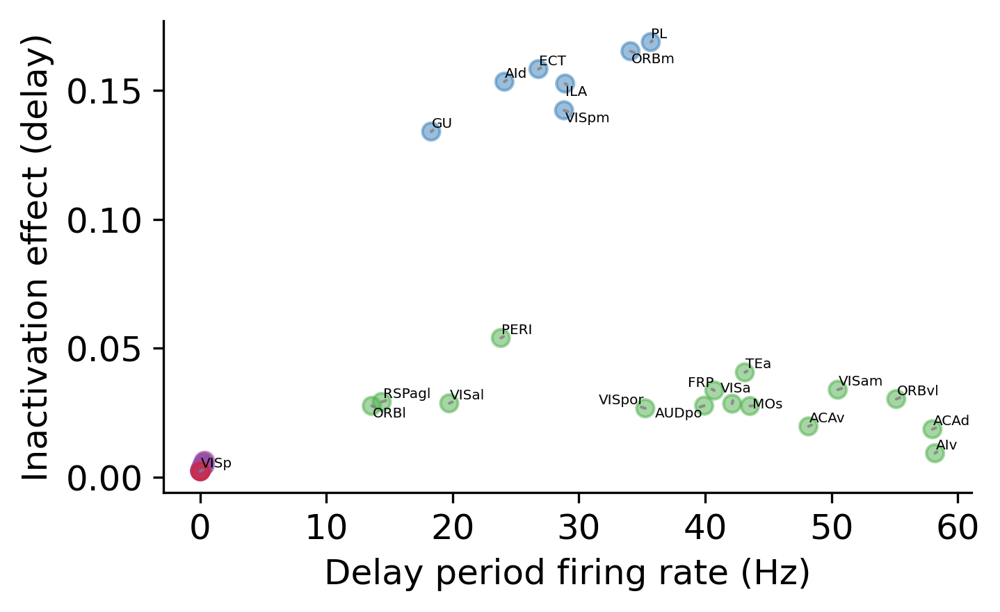

In [26]:
plotDelayInhibitionAndDefault(StimInhfrList, DelayInhfrList, categoryList, frListdefault, FRDefault, area_list, noLabelAreas2, (5,3), 12, True, 'singleAreaLesion/delayFRInhibition.svg')

In [27]:
def plotDelayInhibition3D(StimInhfrList, DelayInhfrList, categoryList, frListdefault, FRDefault, area_list, noLabelAreas, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    ax = plt.axes(projection='3d')
    
    stimEffect = 1 - StimInhfrList / FRDefault
    delayEffect = 1 - DelayInhfrList / FRDefault
    cList = []
    texts = []
    xPos = []
    yPos = []
    zPos = []
    # ax = plt.gca()    
    for i in range(len(area_list)):
        if categoryList[i] == 'input':
            cList += ['#e41a1c'] # input
        elif categoryList[i] == 'core':
            cList += ['#377eb8'] # core
        elif categoryList[i] == 'sustain':
            cList += ['#4daf4a'] # readout
        else:
            cList += ['#984ea3'] # exterior
        acr = area_list[i]
        x = stimEffect[i]
        y = delayEffect[i]
        z = frListdefault[i]

        if acr not in noLabelAreas:
            xPos += [x]
            yPos += [y]
            zPos += [z]
            texts += [ax.text(x, y, z, acr, c='k',fontsize=fontSize*0.5)]
    
    ax.scatter3D(stimEffect, delayEffect, frListdefault, c=cList, alpha=0.5)
    ax.scatter3D(stimEffect[0], delayEffect[0], frListdefault[0], c=cList[0], alpha=0.5) # make VISp show up
    
    # adjust_text(texts, xPos, yPos,
    #                     ax=ax, precision=0.001,
    #                     arrowprops=dict(arrowstyle='-', color='gray', alpha=.8))

    plt.xlabel('Inactivation effect (stimulus)')
    plt.xticks(fontsize=fontSize*0.8)
    plt.ylabel('Inactivation effect (delay)')
    plt.yticks(fontsize=fontSize*0.8)
    ax.set_zlabel('Delay period firing rate (Hz)')
    ax.tick_params(axis='z', labelsize=fontSize*0.8)
    # ax.spines['top'].set_visible(False)
    # ax.spines['right'].set_visible(False)
# save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight',transparent=True)
    # plt.savefig('figure/neurondensity_grad.png',dpi=80,bbox_inc


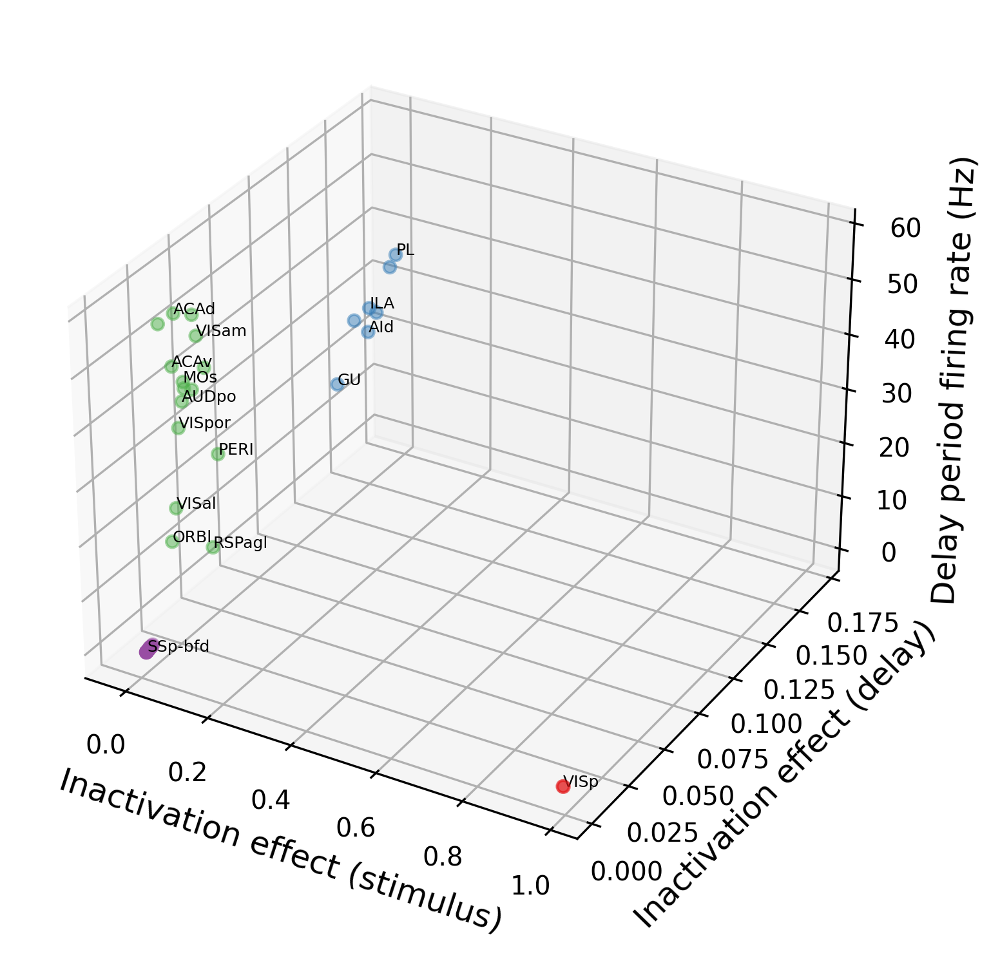

In [28]:
noLabelAreas3d = ['RSPd','RSPv','VISpl','VISrl','MOp','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','AIp','SSp-ul','SSp-n','AUDd','SSp-ll','AUDp',
'ECT','ORBvl','VISC','FRP','VISa', 'VISpm', 'AIv','ORBm', 'TEa'] 
# note that the position of label of SSp-bfd should be changed adhoc. 
plotDelayInhibition3D(StimInhfrList, DelayInhfrList, categoryList, frListdefault, FRDefault, area_list, noLabelAreas3d, (10,6), 12, True, 'singleAreaLesion/delayFRInhibition3D.svg')

In [29]:
def generateColor(colorList, area_list):
    allstring = '{' 
    categoryMapping = {'input':[228,26,28], 'core':[55, 126, 184], 'sustain':[77,175,74], 'irrelavent':[152,78,163]}
    colorList = [categoryMapping[x] for x in categoryList]
    for i in range(len(area_list)):
        newstr = '"' + area_list[i] + '1":{},'.format(i + 1)
        allstring += newstr #allstring stores the names of all cortical areas 
#         cval = colorList[i]
#         norm = mpl.colors.Normalize(vmin=0, vmax=1)
#         mycolor = list(cmap(norm(cval / maxval))[0:3])
#         colorCode = [int(255*mycolor[0]), int(255*mycolor[1]), int(255*mycolor[2])]
#         colorList.append(colorCode)
    allstring = allstring[:-1] + '}'
    return allstring, colorList


# print(categoryColorList)

mapStr, categorycolorMap = generateColor(categoryList, area_list)
print(mapStr)
print(categorycolorMap)

{"VISp1":1,"AUDp1":2,"SSp-ll1":3,"AUDd1":4,"SSp-n1":5,"SSp-ul1":6,"AIp1":7,"SSp-m1":8,"SSp-un1":9,"SSp-bfd1":10,"VISl1":11,"AUDv1":12,"SSs1":13,"VISC1":14,"SSp-tr1":15,"VISli1":16,"MOp1":17,"VISrl1":18,"VISpl1":19,"RSPv1":20,"RSPd1":21,"GU1":22,"RSPagl1":23,"PERI1":24,"ECT1":25,"VISal1":26,"ILA1":27,"ORBl1":28,"AId1":29,"VISpm1":30,"ORBm1":31,"PL1":32,"VISpor1":33,"FRP1":34,"AUDpo1":35,"TEa1":36,"VISa1":37,"VISam1":38,"MOs1":39,"ORBvl1":40,"ACAv1":41,"ACAd1":42,"AIv1":43}
[[228, 26, 28], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [152, 78, 163], [55, 126, 184], [77, 175, 74], [77, 175, 74], [55, 126, 184], [77, 175, 74], [55, 126, 184], [77, 175, 74], [55, 126, 184], [55, 126, 184], [55, 126, 184], [55, 126, 184], [77, 175, 74], 

In [30]:
# load loop  mm11

with open('results/plainLoopStr.json', 'r') as f:
    sLoop = json.load(f)

with open('results/plainLoopStr3.json', 'r') as f:
    ssLoop = json.load(f)

with open('results/hierLoopStr.json', 'r') as f:
    sLoopHier = json.load(f)

with open('results/hierLoopStr3.json', 'r') as f:
    ssLoopHier = json.load(f)



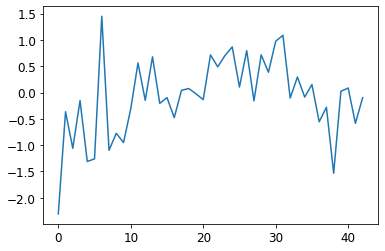

In [31]:
plt.plot(sLoopHier)
# plt.plot(eigCentX)

In [32]:
# coreAreaList = ['GU', 'RSPagl', 'PERI', 'ECT', 'VISal', 'ILA', 'AId', 'VISpm', 'ORBm', 'PL'] # ORBl
coreAreaList = ['GU', 'PERI', 'ECT', 'ILA', 'AId', 'VISpm', 'ORBm', 'PL']
coreArea01List = np.array([int(x == 'core') for x in categoryList])


In [33]:
## chisquared test for loop
# from scipy.stats import chi2_contingency
# #           core    non-core
# # posLoop     10.        9
# # negLoop    0         24

# data = [[10,9], [0, 24]]
# stat, p, dof, expected = chi2_contingency(data)
# print(stat, p, dof, expected)

In [ ]:
# TODO: calculate AUC for each simulation. 

# import numpy as np
# import scipy as sp
# import pandas
# import brian2
# import copy
# import seaborn as sns
# from adjustText import adjust_text
# import matplotlib.pyplot as plt
# import statsmodels.api as sm
# from sklearn.metrics import roc_auc_score

# from sklearn.model_selection import train_test_split
# from sklearn.linear_model import LogisticRegression
# from sklearn.preprocessing import StandardScaler
# from sklearn.metrics import accuracy_score

# def plotXYLogReg(X, Y, Xlabel, Ylabel, showLabel, parameters, area_list, noLabelAreas, frThreshold, figureSize,
#                  fontSize, saveFig, fileName):
#     div_name_list, div_color_list = parameters['div_name_list'], parameters['div_color_list']
#     div = parameters['div']

#     Ycopy = copy.copy(Y)
#     Xnorm = X / X.max()
#     X2d = Xnorm.reshape((-1, 1))
#     Ynorm = np.array([int(x) for x in Ycopy >= frThreshold])
#     print(Ynorm)

#         # Sample data
#     # X is your feature matrix, y is your target vector
#     # For instance, X might be the ages, and y might be binary labels (1 for High Wealth, 0 for Low Wealth)

#     # Splitting the data into training and testing sets
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

#     # Scaling the features (especially important if you have multiple features of different scales)
#     scaler = StandardScaler()
#     X_train_scaled = scaler.fit_transform(X_train)
#     X_test_scaled = scaler.transform(X_test)

#     # Training a logistic regression model
#     clf = LogisticRegression()
#     clf.fit(X_train_scaled, y_train)

#     # Predicting on the test set
#     y_pred = clf.predict(X_test_scaled)

#     # Evaluating the model
#     accuracy = accuracy_score(y_test, y_pred)
#     print(f"Accuracy: {accuracy:.2f}")


#     #     logR = LogisticRegression(solver='liblinear', random_state=77).fit(X2d, Ynorm)
#     #     c1, c0 = logR.coef_[0][0], logR.intercept_[0]
#     #     print(c1, c0, logR.score(X2d, Ynorm), logR)

#     exog, endog = sm.add_constant(X2d), Ynorm
#     logRmodel = sm.GLM(endog, exog, family=sm.families.Binomial(link=sm.families.links.logit))
#     # link function is logit, the inverse of sigmoid. Xb = g(u). g is link function. b is independent varible. u is dependent varible.
#     logR = logRmodel.fit()
#     #     print(logR.summary(), logR.params)
    
#     # roc_auc_score(Ynorm, logR.predict(exog))

#     fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
#     plt.rcParams.update({'font.size': fontSize})
#     g1 = sns.regplot(Xnorm, Ynorm, logistic=True, ci=None, scatter=False)
#     plt.scatter(Xnorm, Ynorm, alpha=0.3, edgecolor='none')

#     ax = plt.gca()
#     if showLabel:
#         texts = []
#         xPos = []
#         yPos = []
#         for i in range(len(area_list)):
#             acr = area_list[i]
#             for div_name, div_color in zip(div_name_list, div_color_list):
#                 if acr in div[div_name] and acr not in noLabelAreas:
#                     xPos += Xnorm[i]
#                     yPos += Ynorm[i]
#                     texts += [ax.text(Xnorm[i], Ynorm[i], acr,
#                                       color=div_color, fontsize=fontSize * 0.4)]

#         # # use adjust library to adjust the position of annotations.
#         if True:
#             adjust_text(texts, Xnorm, Ynorm,
#                         ax=ax, precision=0.001,
#                         arrowprops=dict(arrowstyle='-', color='gray', alpha=.8))

#     c1, c0 = logR.params[1], logR.params[0]
#     x = c1 * Xnorm + c0
#     yPred = 1 / (1 + np.exp(-x)) >= 0.5
#     yScore = sum(yPred == Ynorm) / len(Ynorm)


#     #     plt.scatter(Xnorm, 1 / (1 + np.exp(-k)))  # TODO chekc more
#     #     plt.scatter(Xnorm, yPred)

#     plt.xlabel(Xlabel)
#     plt.ylabel(Ylabel)
#     plt.xlim([min(Xnorm) - 0.05, max(Xnorm) + 0.05])

#     print(['prediction score', yScore])

#     axes = plt.gca()
#     axes.spines['top'].set_visible(False)
#     axes.spines['right'].set_visible(False)
#     if saveFig:
#         fig.savefig('figure/' + fileName, dpi=300, bbox_inches='tight', transparent=True)
#     return {'prediction score': yScore}


WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.8372093023255814]


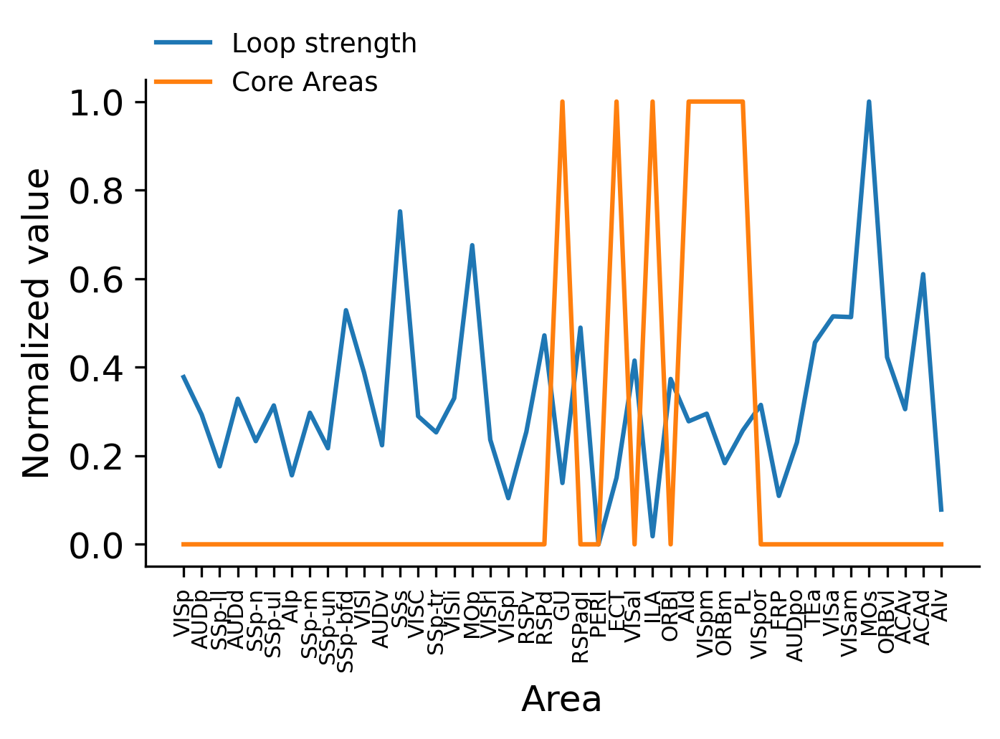

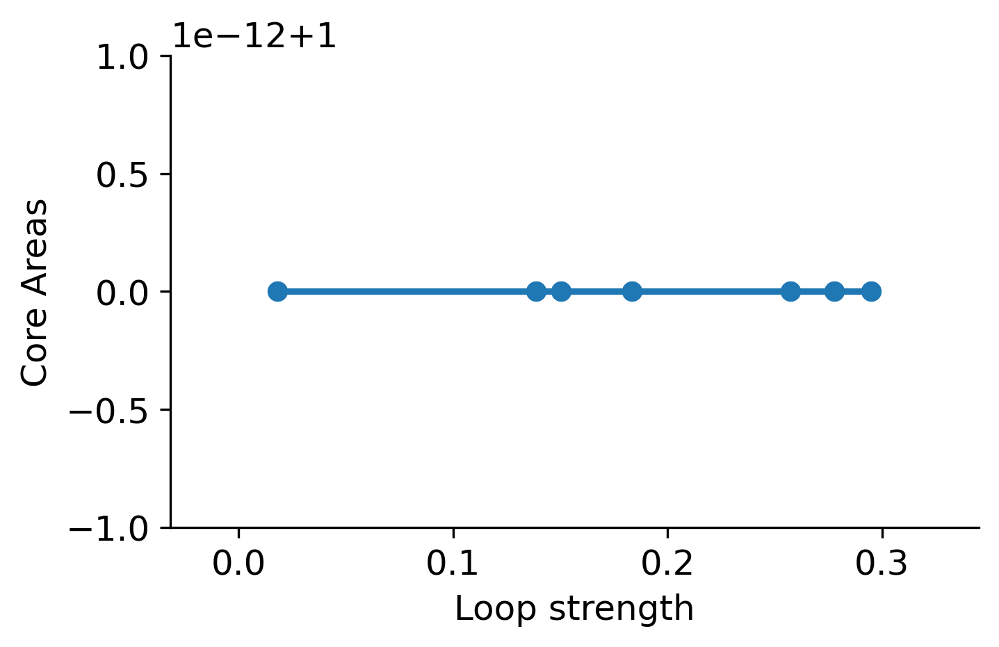

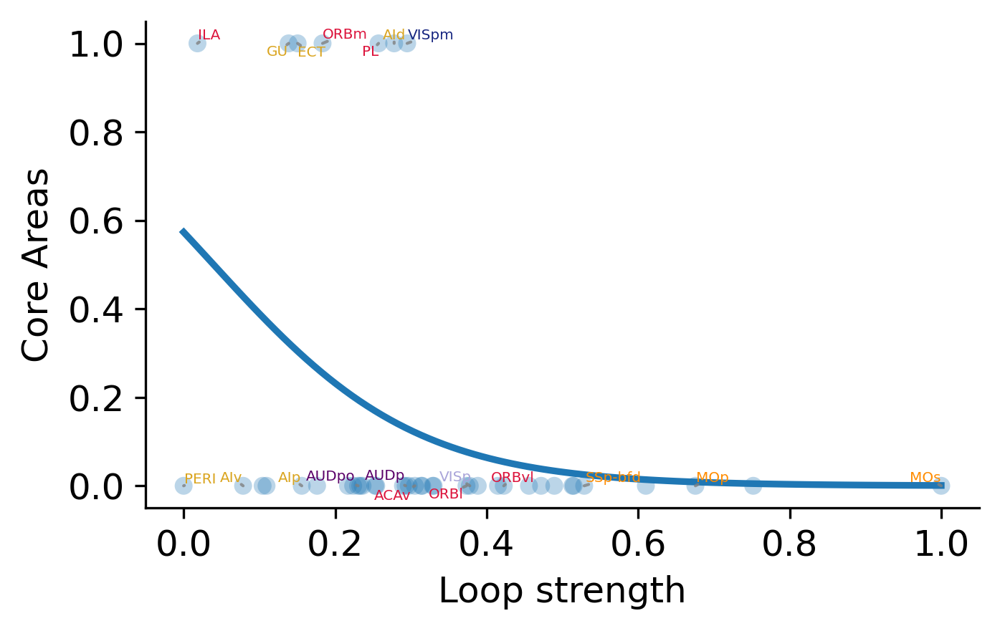

In [34]:
X = np.array(sLoop)
X = (X - X.min()) / (X.max() - X.min())
# Y = 1 - frList[1:] / FRDefault 
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loopVScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loopVScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold

In [35]:
np.abs(np.array(sLoopHier)).max()

2.307422431546596

WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.9069767441860465]


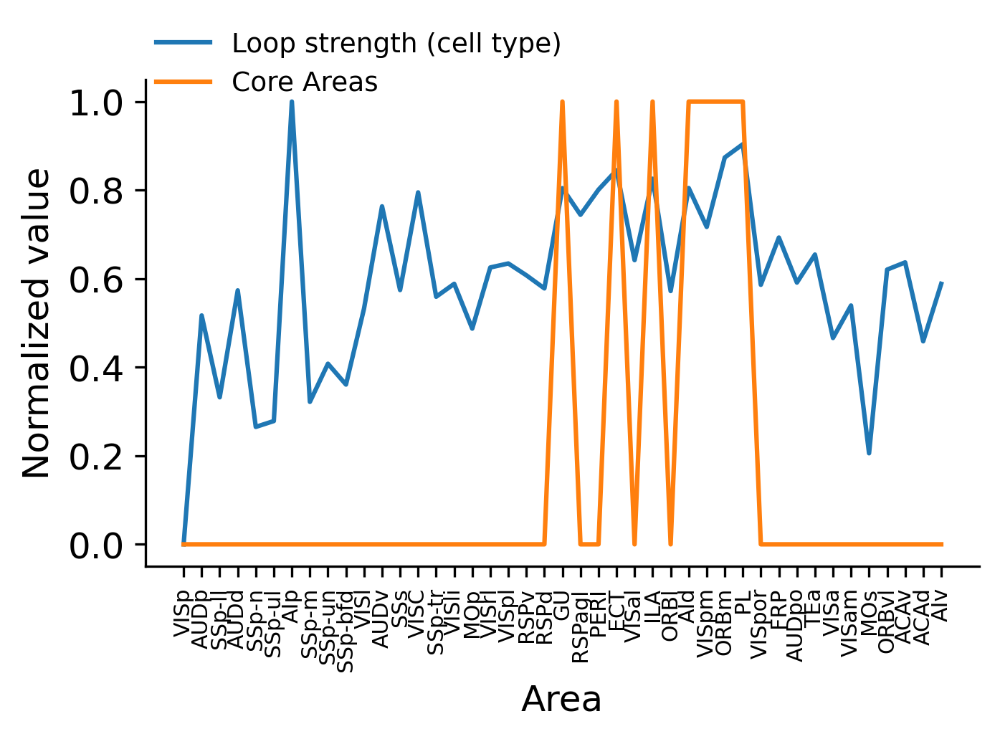

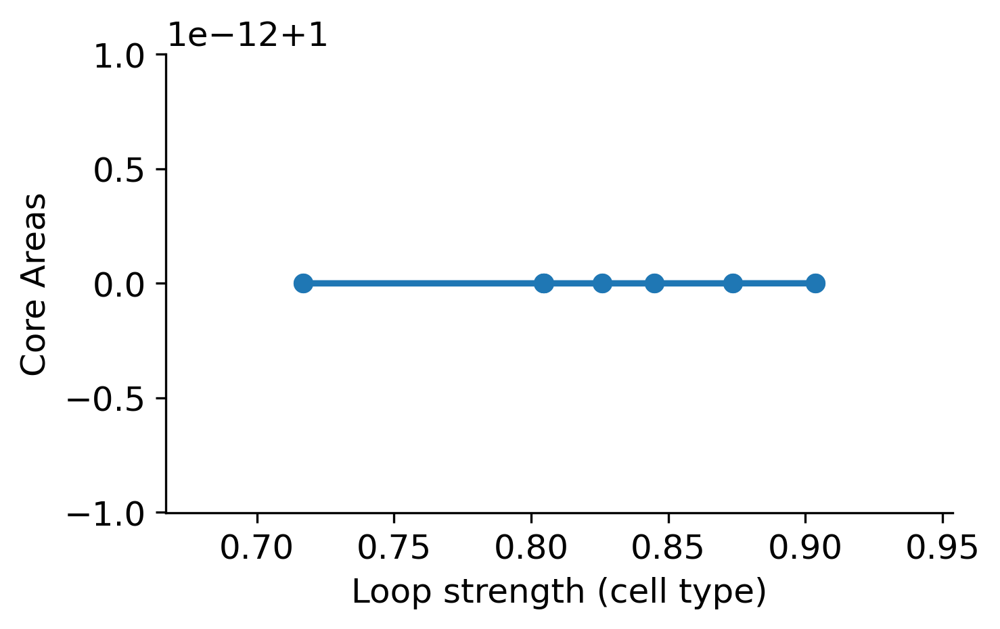

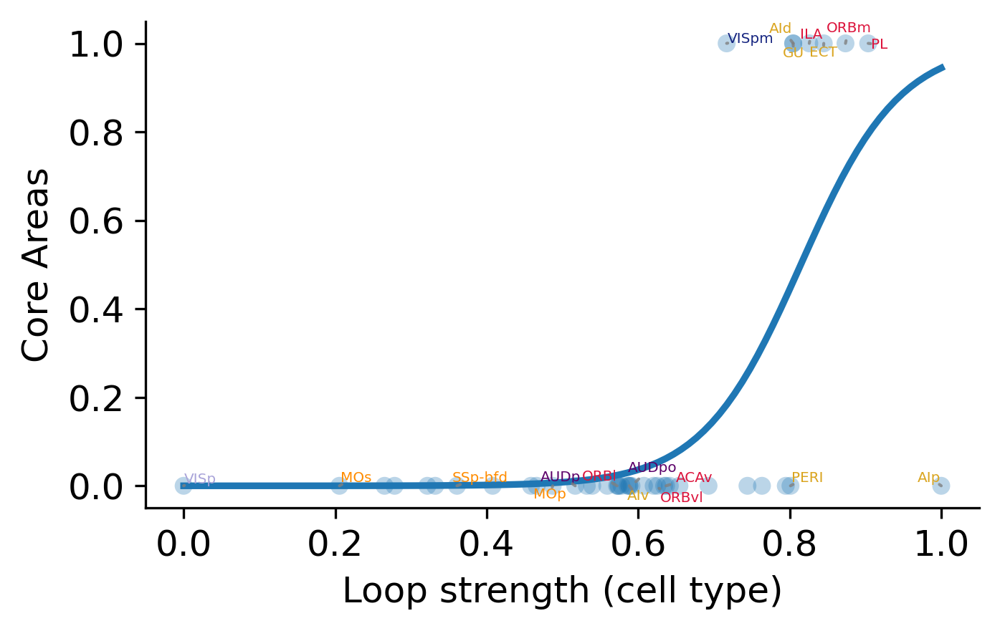

In [36]:
# mm33
X = np.array(sLoopHier)
X = (X - X.min()) / (X.max() - X.min())
# X = X / np.abs(X).max()
# X = (X - X.min()) / (X.max() - X.min())
# Y = 1 - frList[1:] / FRDefault 
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength (cell type)'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loopHierVScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loopHierVScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold

WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.8372093023255814]


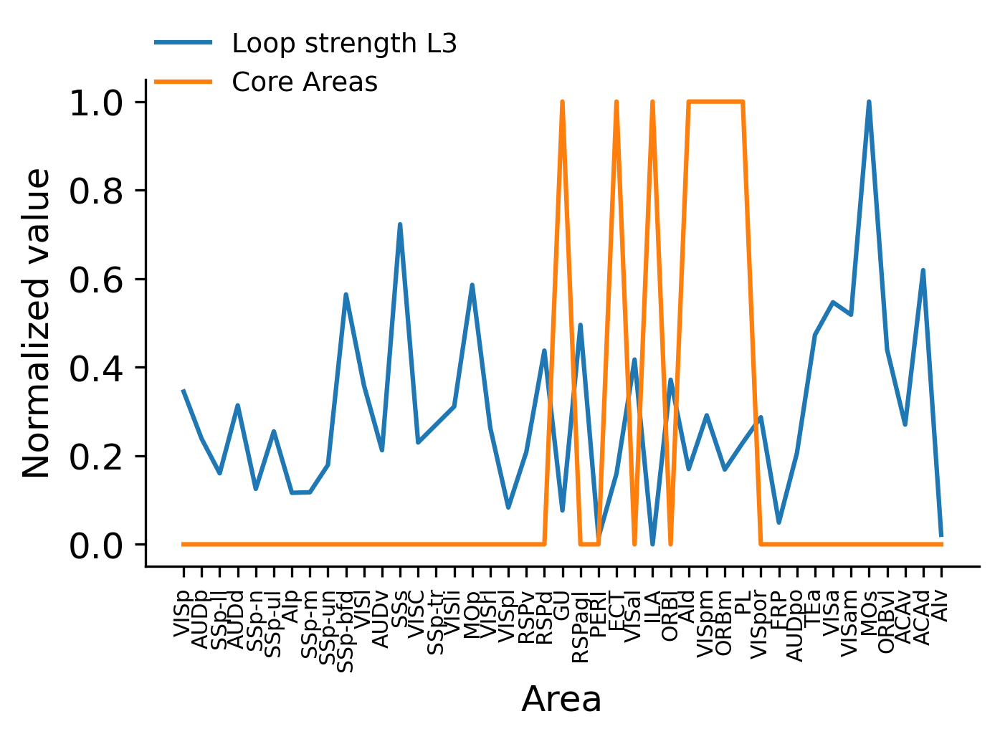

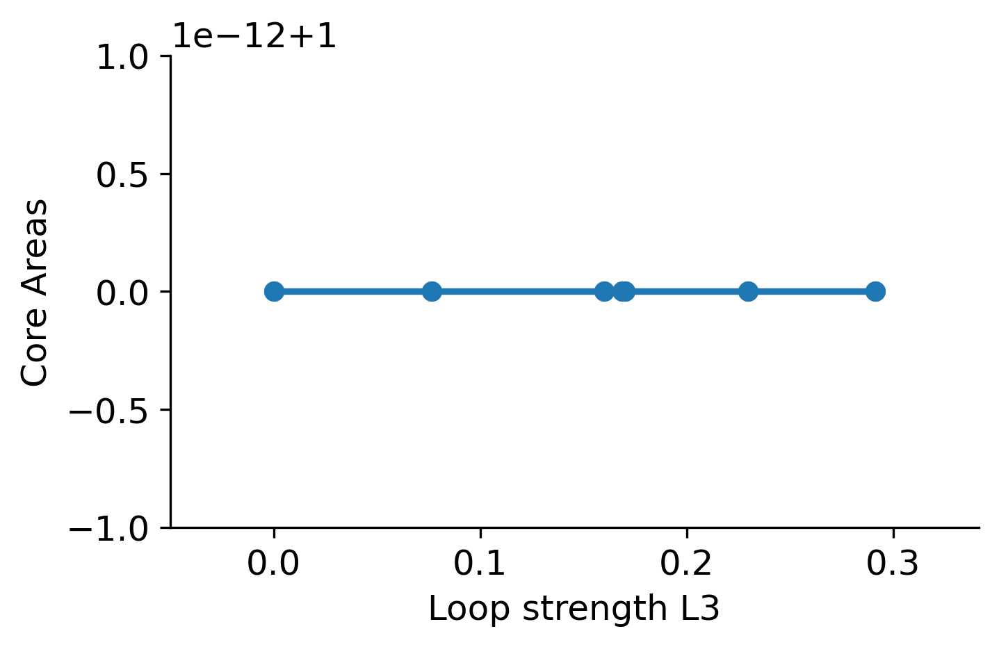

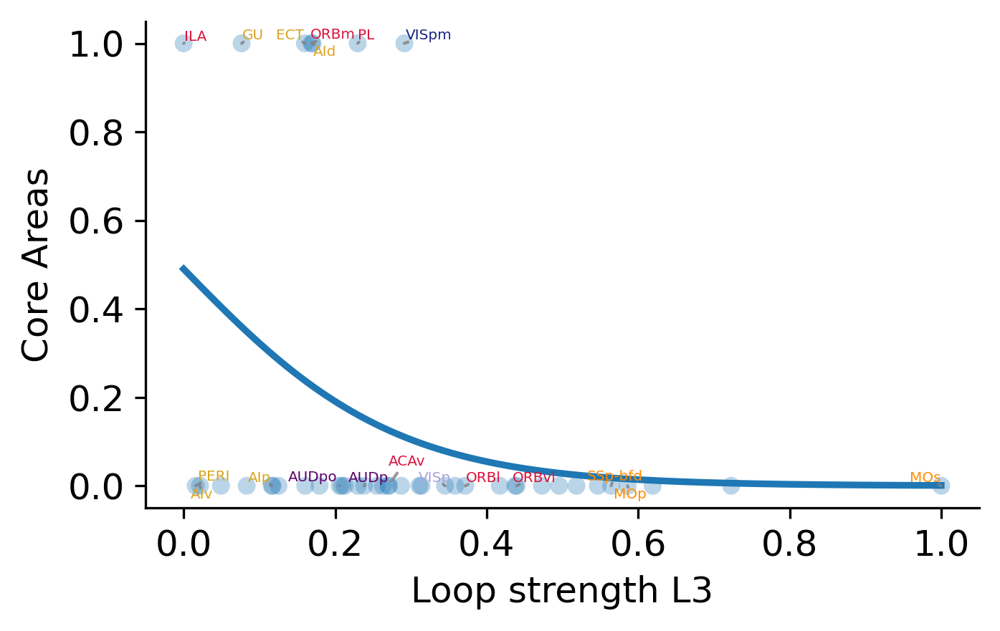

In [37]:
X = np.array(ssLoop)
X = (X - X.min()) / (X.max() - X.min())
# Y = 1 - frList[1:] / FRDefault 
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength L3'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loop3VScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loop3VScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold

WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.9069767441860465]


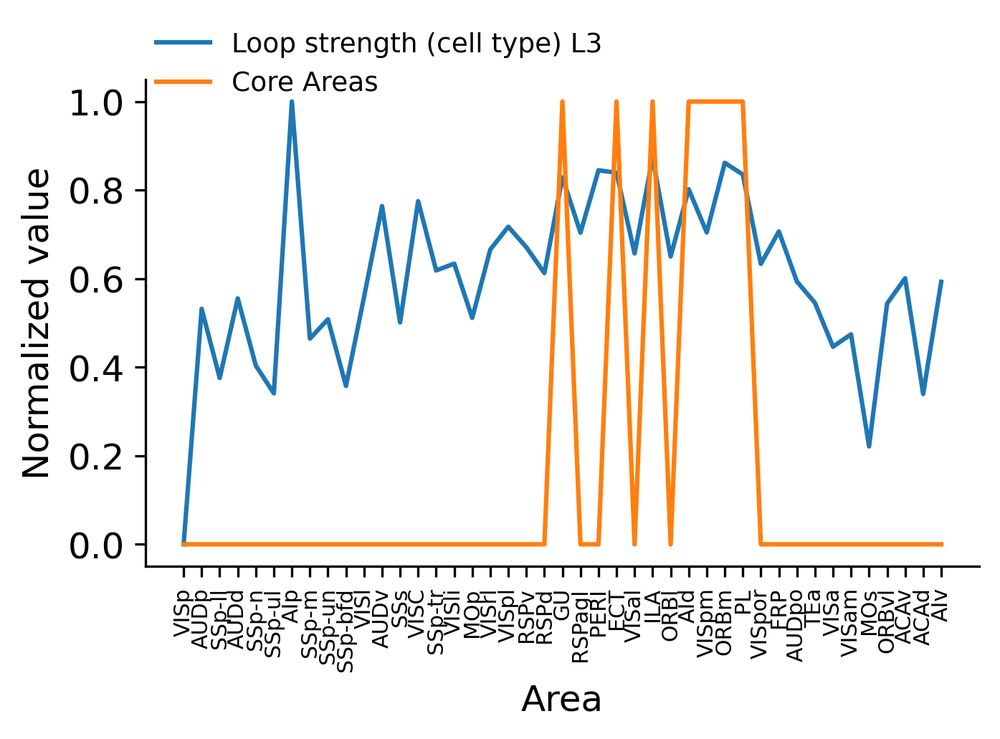

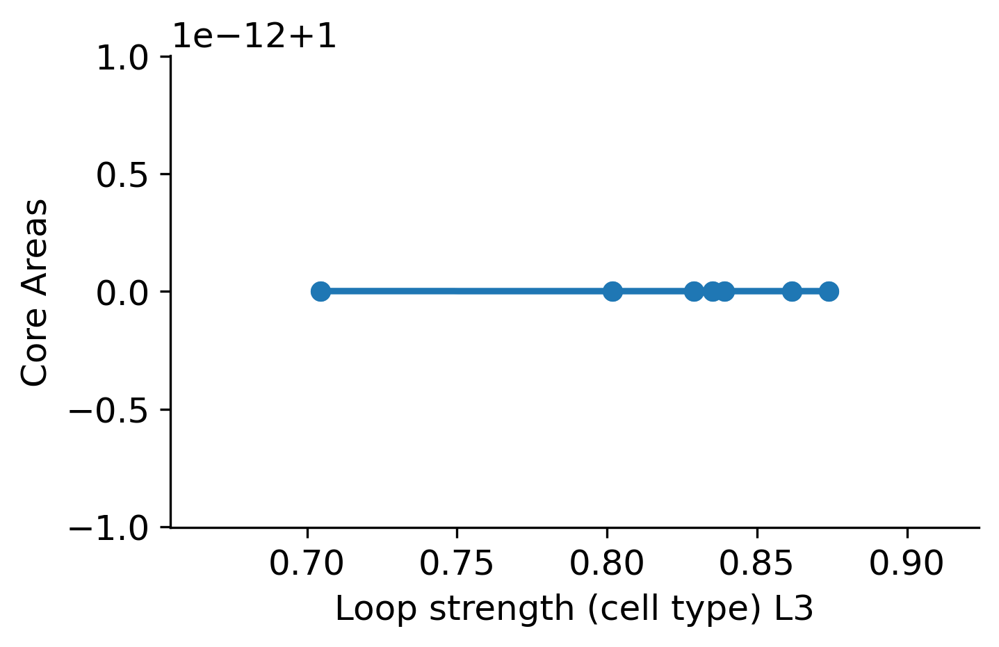

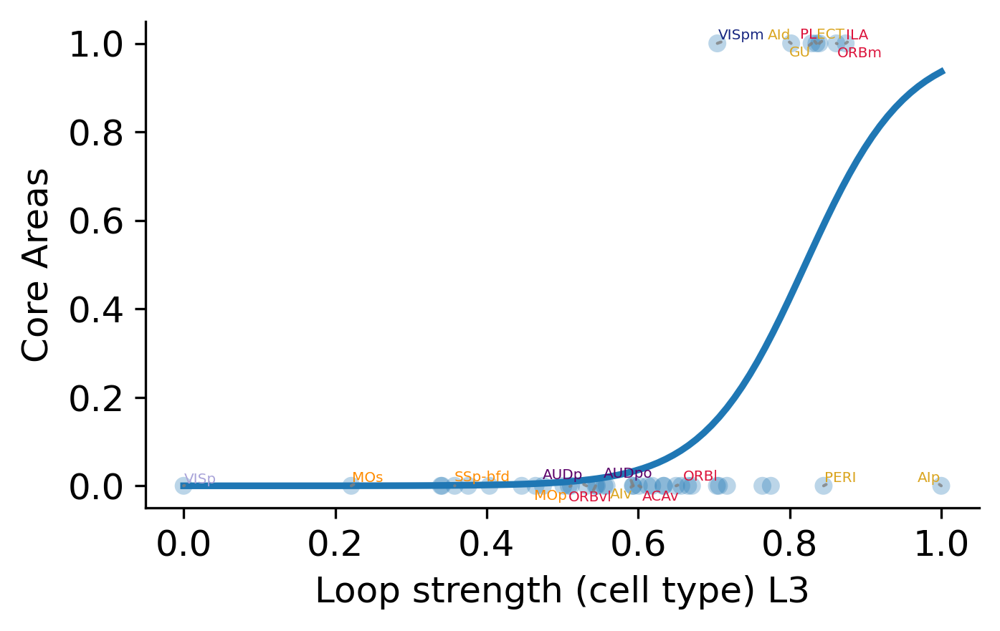

In [38]:
X = np.array(ssLoopHier)
X = (X - X.min()) / (X.max() - X.min())
# Y = 1 - frList[1:] / FRDefault 
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength (cell type) L3'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loopHier3VScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loopHier3VScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold

In [40]:
# newsim: load sign only loop 
with open('results/sign_onlyLoopStr.json', 'r') as f:
    sLoop_sign_only = json.load(f)

with open('results/sign_onlyLoopStr3.json', 'r') as f:
    ssLoop_sign_only = json.load(f)

# newsim: load noPV loop 
with open('results/noPVLoopStr.json', 'r') as f:
    sLoop_noPV = json.load(f)

with open('results/noPVLoopStr3.json', 'r') as f:
    ssLoop_noPV = json.load(f)

WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.8372093023255814]


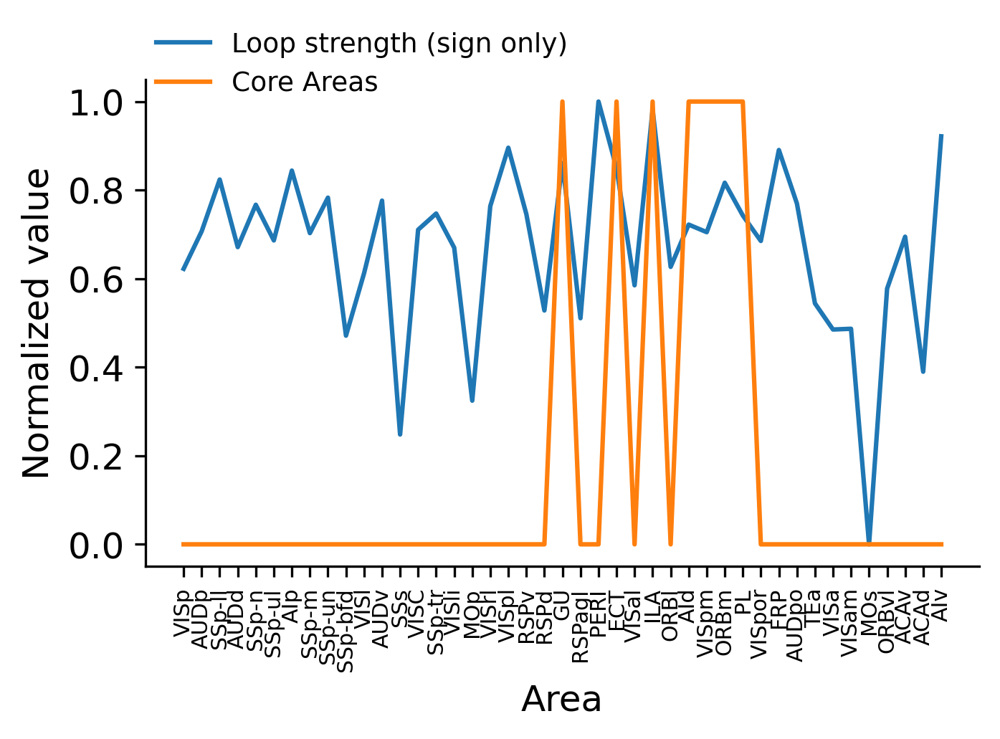

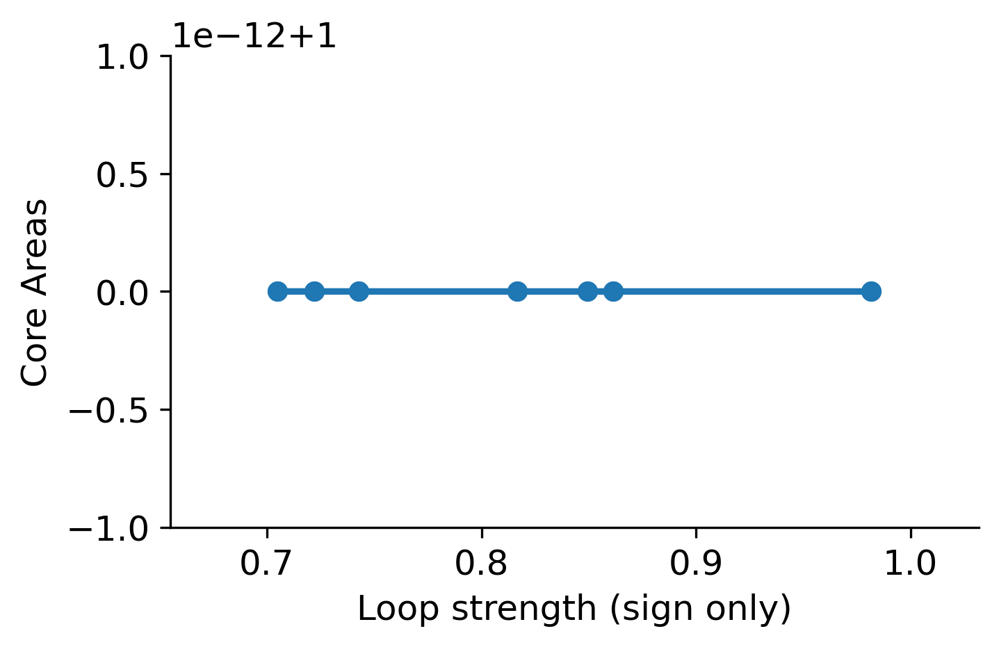

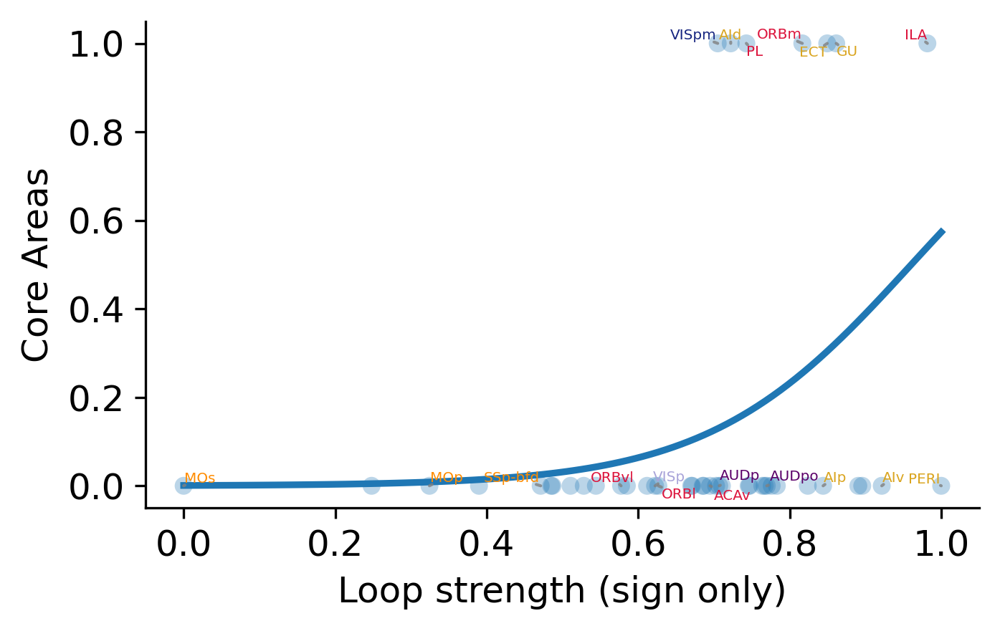

In [41]:
# newsim: sign only loop vs core area
X = np.array(sLoop_sign_only)
X = (X - X.min()) / (X.max() - X.min())
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength (sign only)'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loop_sign_onlyVScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loop_sign_onlyVScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold


WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.8372093023255814]


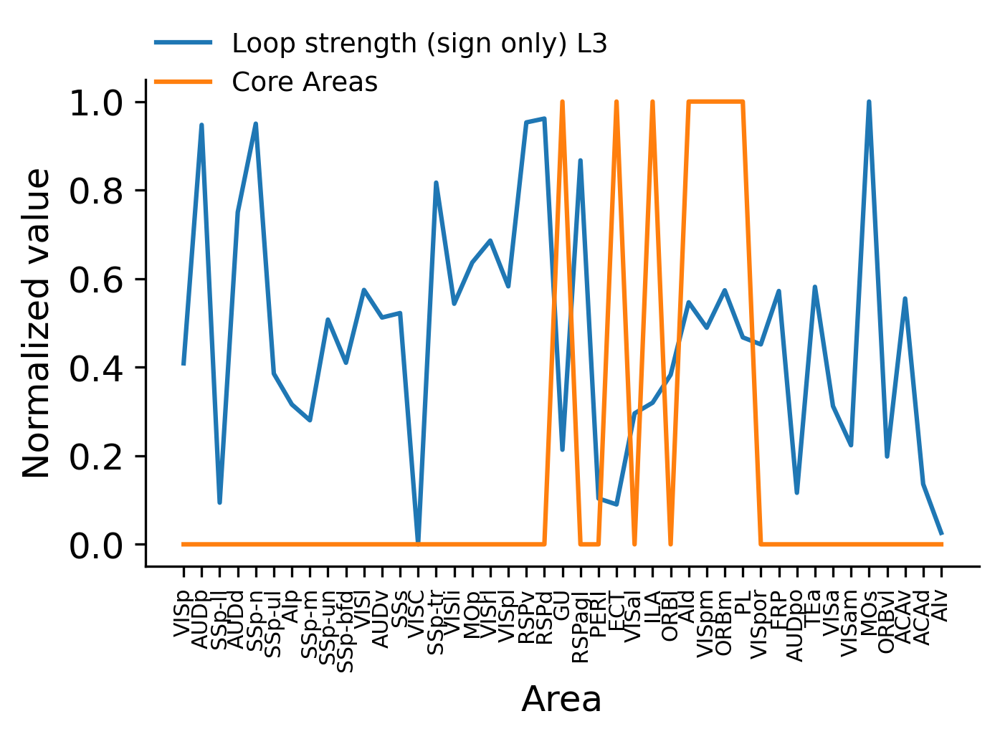

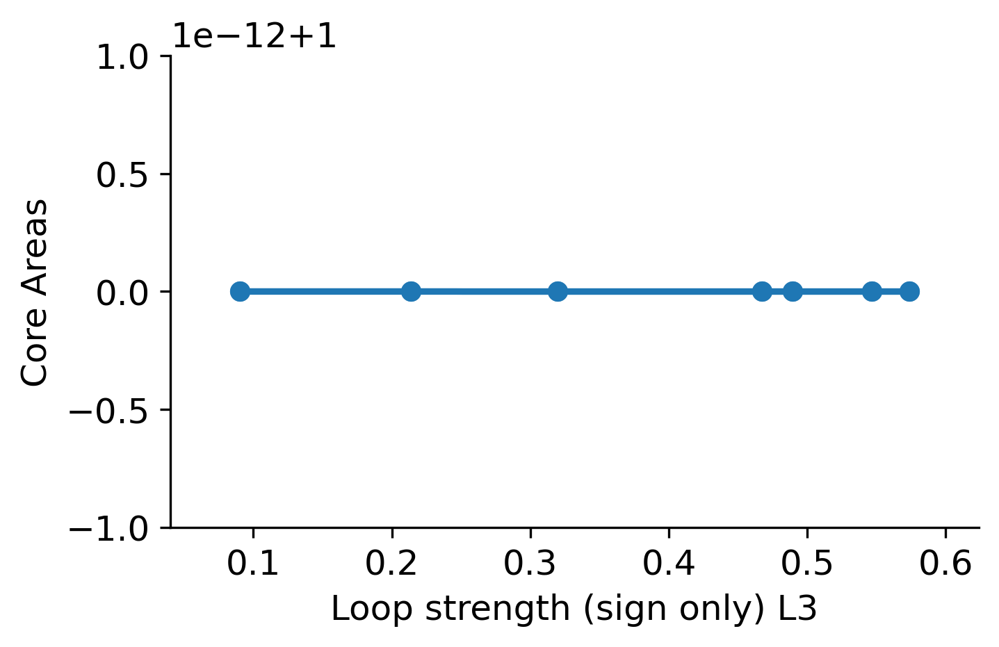

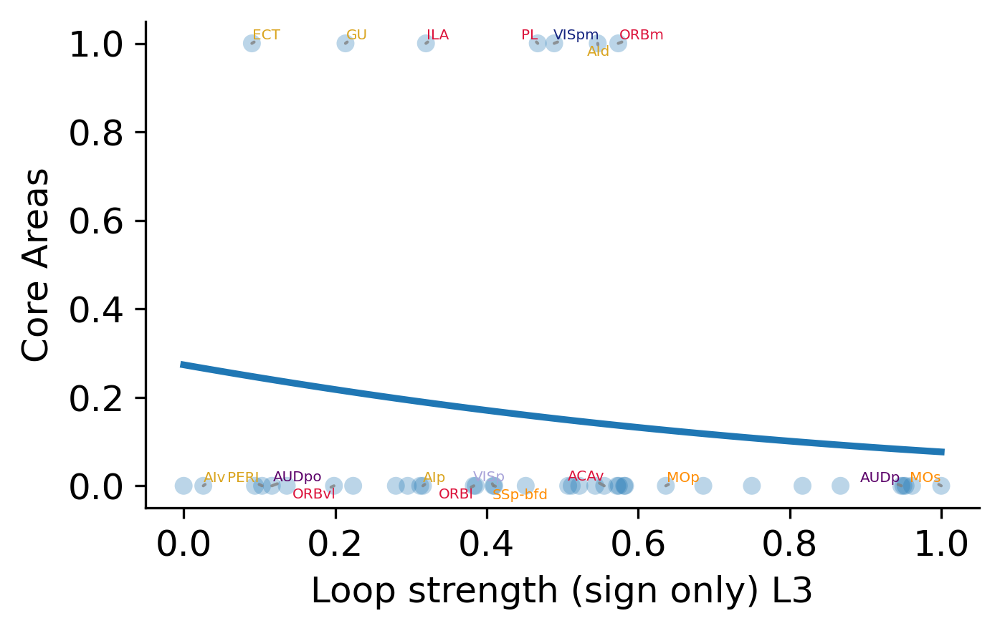

In [42]:
# newsim: sign only loop 3 vs core area
X = np.array(ssLoop_sign_only)
X = (X - X.min()) / (X.max() - X.min())
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength (sign only) L3'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loop_sign_only3VScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loop_sign_only3VScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold


WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.9069767441860465]


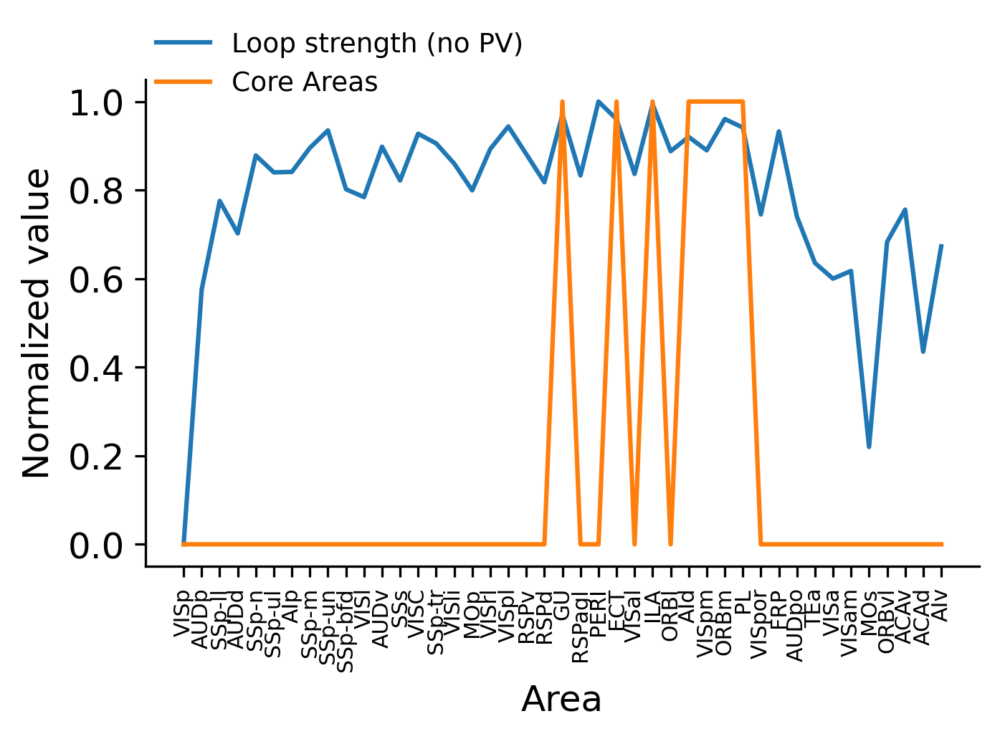

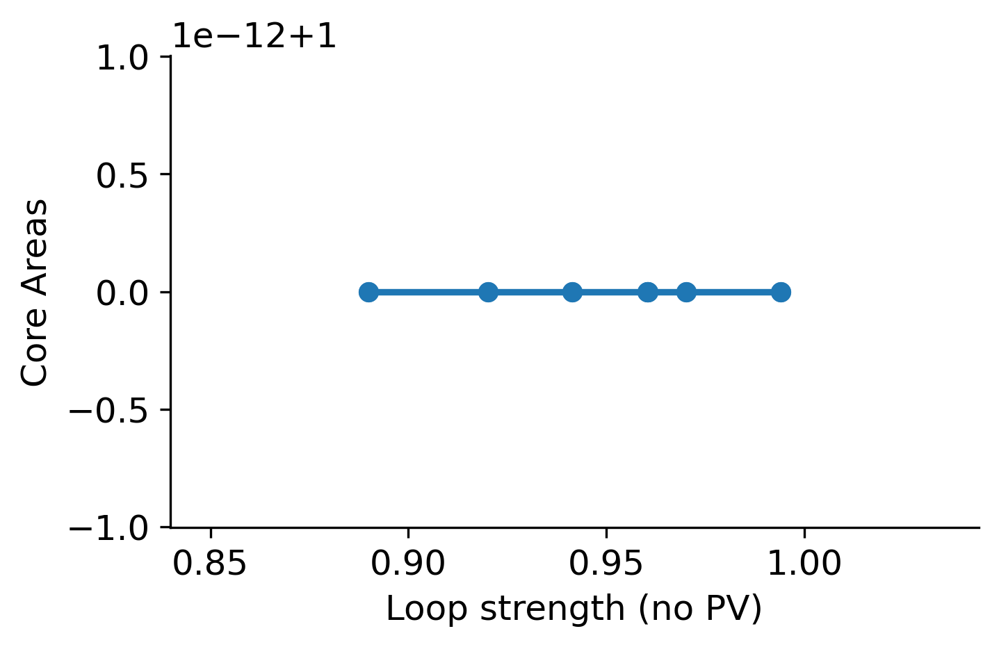

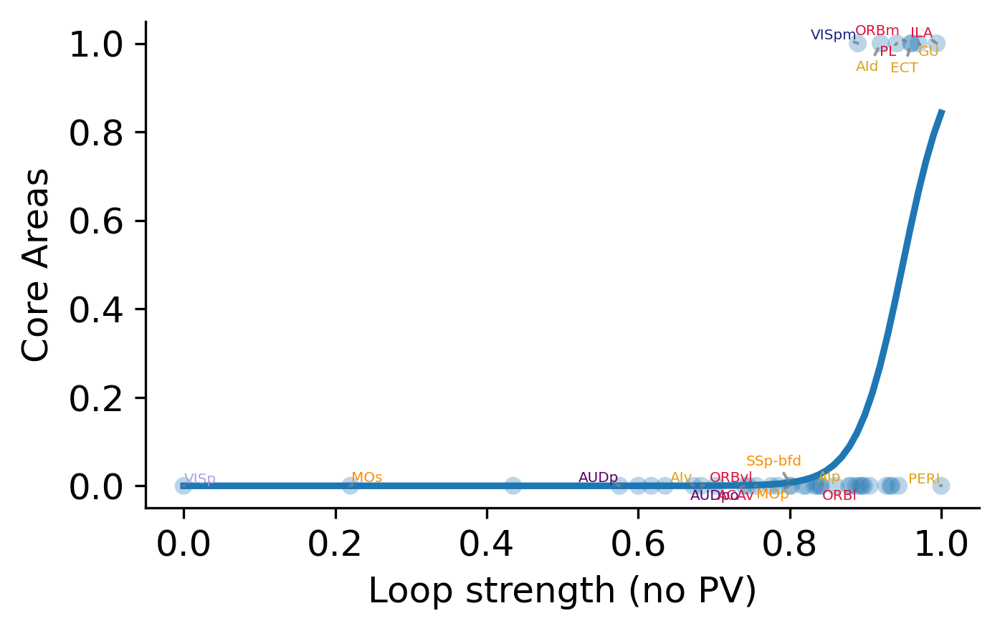

In [45]:
# newsim: no PV loop vs core area
X = np.array(sLoop_noPV)
X = (X - X.min()) / (X.max() - X.min())
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength (no PV)'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loop_noPVVScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loop_noPVVScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold


WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:3038: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
 [py.warnings]
WARNING    /Users/Allen/anaconda3/lib/python3.6/site-packages/scipy/stats/_di

['r', nan, 'r^2', nan, 'pvalue', 1.0, 'rSpear', nan, 'rSpear^2', nan, 'pvalueSpear', nan]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0]
['prediction score', 0.8372093023255814]


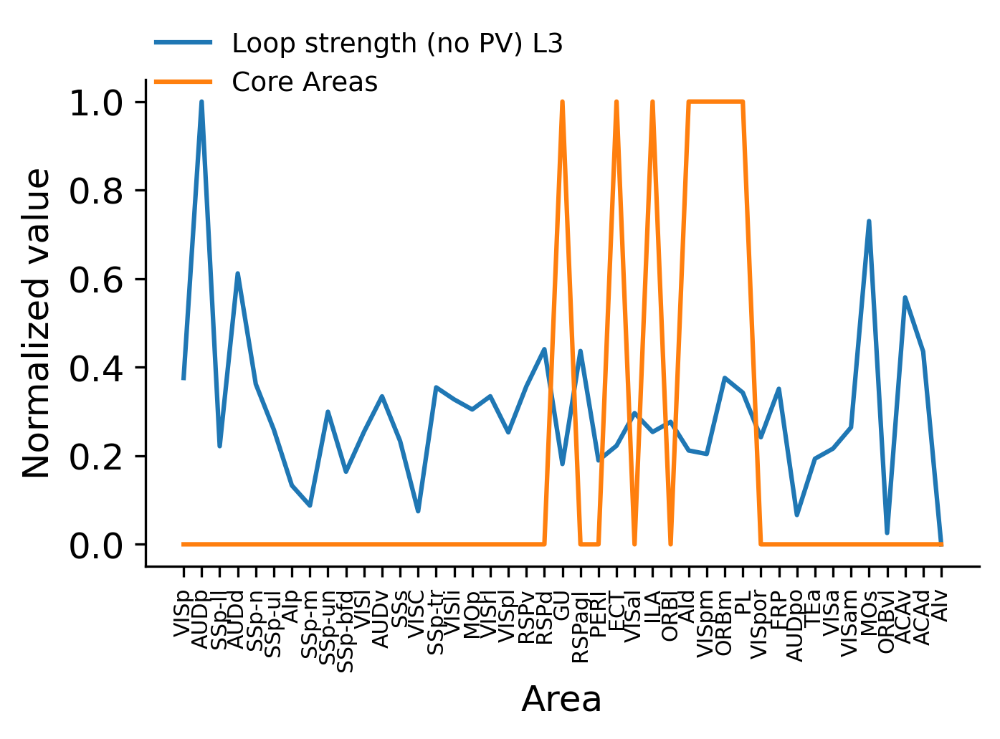

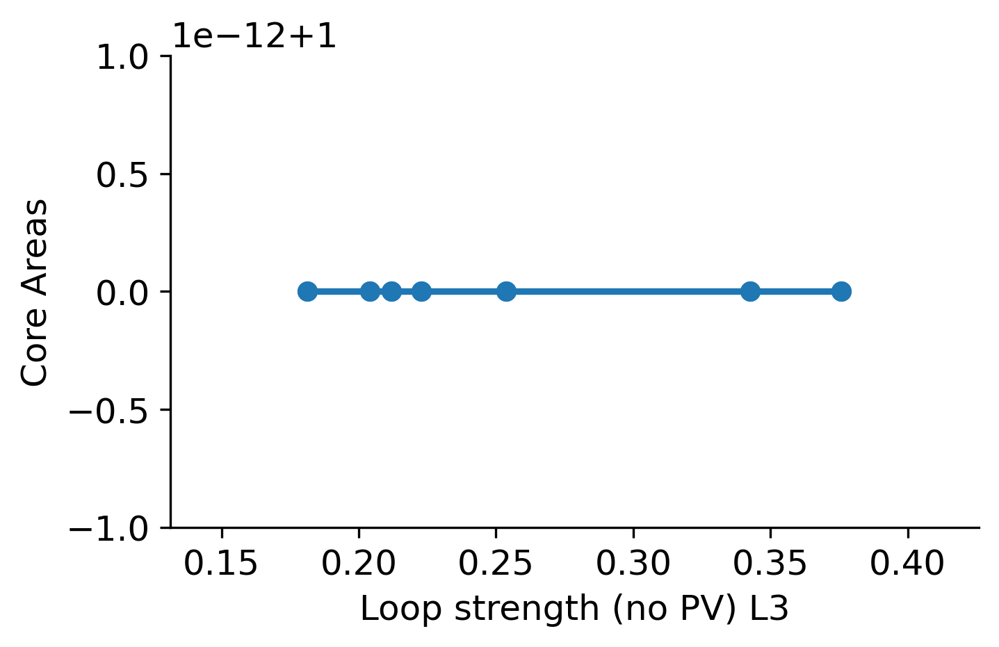

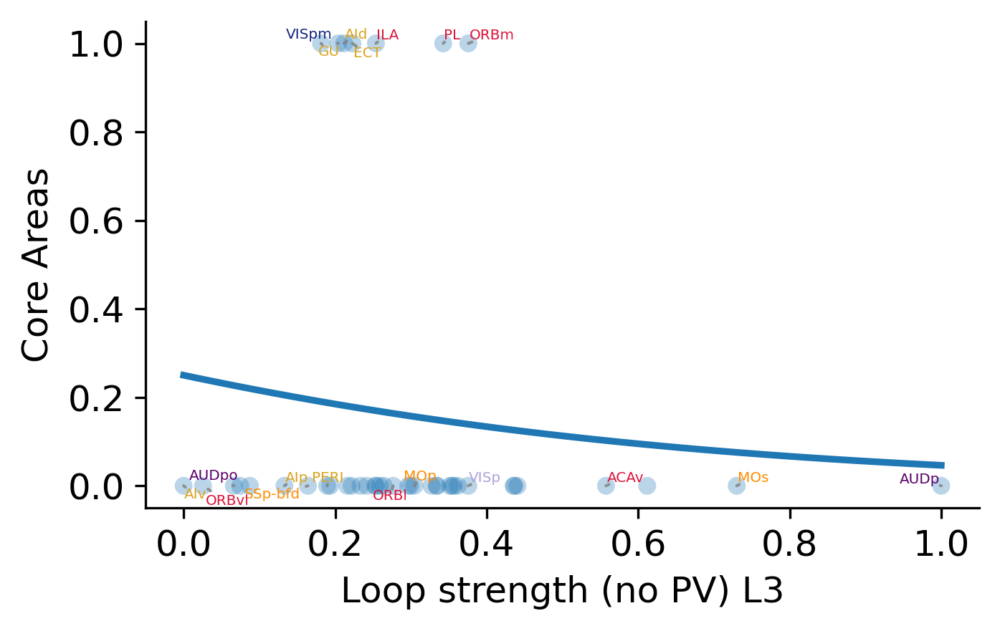

In [46]:
# newsim: noPV loop 3 vs core area
X = np.array(ssLoop_noPV)
X = (X - X.min()) / (X.max() - X.min())
Y = coreArea01List
plotAreaList = area_list

Xlabel = 'Loop strength (no PV) L3'
Ylabel = 'Core Areas'
frThreshold = 0.05
noLabelAreas = ['RSPd','RSPv','VISpl','VISrl','VISli','SSp-tr','VISC','SSs','AUDv','VISl','SSp-un','SSp-m','SSp-ul','SSp-n','AUDd','SSp-ll',
               'ACAd','VISam','VISa','TEa','AUDpao','FRP','VISpor', 'RSPagl', 'VISal',]

plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, True,
            'singleAreaLesion/loop_noPV3VScorePlot.svg')
inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
            'singleAreaLesion/2.svg')
# plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
#             'singleAreaLesion/eig_FRcompr3.svg')
inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel,'Core Areas',  True, parameters, plotAreaList, noLabelAreas, frThreshold, (5, 3), 12, True,
            'singleAreaLesion/loop_noPV3VScoreLogReg.svg') # Y is treated as binary with a threshold of frThreshold


In [43]:
# # calcualte AUC values for loop
# import statsmodels.api as sm
# import sklearn.metrics
# Ycopy = copy.copy(Y)
# Xnorm = X / X.max()
# X2d = Xnorm.reshape((-1, 1))
# Ynorm = np.array([int(x) for x in Ycopy >= frThreshold])
# # print(Ynorm)
# # print(X2d)

# exog, endog = sm.add_constant(X2d), Ynorm
# logRmodel = sm.GLM(endog, exog, family=sm.families.Binomial(link=sm.families.links.logit))
#     # link function is logit, the inverse of sigmoid. Xb = g(u). g is link function. b is independent varible. u is dependent varible.
# logR = logRmodel.fit()
# # print(exog, endog)
# c1, c0 = logR.params[1], logR.params[0]
# x = c1 * Xnorm + c0
# yPred = 1 / (1 + np.exp(-x)) >= 0.5
# yScore = sum(yPred == Ynorm) / len(Ynorm)

# print(c1, c0)

# p = c1 * Xnorm + c0
# yp = 1/(1 + np.exp(-x))
# plt.plot(yp)
# plt.plot(Ynorm)

# print(yp)
# fpr, tpr, thresholds = sklearn.metrics.roc_curve(y_true=Ynorm, y_score=yp)
# auroc = sklearn.metrics.auc(fpr, tpr)
# plt.figure()
# plt.plot(fpr, tpr)


# ypALL = np.zeros(n_areas)
# fprALL, tprALL, thresholdsALL = sklearn.metrics.roc_curve(y_true=Ynorm, y_score=ypALL)
# aurocALL = sklearn.metrics.auc(fprALL, tprALL)
# plt.figure()
# plt.plot(fprALL, tprALL)

# print(fpr, tpr, thresholds)
# print(auroc)

# print(fprALL, tprALL, thresholdsALL)
# print(aurocALL)


In [44]:
# X = np.array(eigCentX)[:-1]
# Y = frList[:-1] / FRDefault
# plotAreaList = area_list[:-1]
# # X = (X - X.min()) / (X.max() - X.min())
# Xlabel = 'EigenCentrality (cell-type)'
# Ylabel = 'Lesion effect(decrement)'
# frThreshold = 0
# noLabelAreas = []
# plotXYcompr(X, Y, Xlabel, Ylabel, plotAreaList, (5, 3), 12, False,
#             'singleAreaLesion/1.svg')
# inpHiermodCorr = plotXYcomprCorr(X, Y, Xlabel, Ylabel, parameters, False, plotAreaList, frThreshold, (5, 3), 12, False,
#             'singleAreaLesion/2.svg')
# # plotXYcomprResidual(X, Y, Xlabel, frThreshold, (5, 3), 12, True,
# #             'singleAreaLesion/eig_FRcompr3.svg')
# inpHiermodLogReg = plotXYLogReg(X, Y, Xlabel, 'Lesion effect category',  True, parameters, plotAreaList, noLabelAreas, 0.95, (5, 3), 12, False,
#             'singleAreaLesion/3.svg') # Y is treated as binary with a threshold of frThreshold


In [45]:
# possible formula of loops to check
# S_Ai = sum(Lijk)  Lijk = wij^1/3 * wjk^1/3 * wki^1/3  
# 1 mij * wij
# 2. mij/(1-mij) * wij
# mij - PV(1-mij) * wij
# 1-PV * wij
# mij / PV(1-mij) * wij
# hi * wij
# hj * wij
